In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import pandas_profiling
import warnings
warnings.filterwarnings('ignore')

For my dataset, I am using the Default of Credit Card Clients Dataset accessed here: https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset/download

***Problem statement:*** Credit card companies make money by collecting interest on loans. When a customer is unable to pay, then the loan defaults. Defaults cause credit card companies to lose money by either writing the balance off completely, or by selling the balance to a collection agency for pennies on the dollar.

***Proposal:*** This project will investigate whether customer account information can be used to build machine learning models to successfully predict whether or not a customer will default on their next month's payment. This is a supervised learning problem; the data set has two different labels ((1=yes will default next month, 0=no will not default next month). I will evaluate the performance of six machine learning model frameworks to understand if the dataset has the ability to accurately predict whether a customer will default on their account in the next month.  
The six models used are Logistic Regression, KNN classifier, Bagging classifier, AdaBoost classifier, XGBoost classifier, and Random forest classifier. The hyperparameters will be be optimized and model performance will be evaluated using a confusion matrix, classification report (Precision, Recall, and F1), and Area under the Receiver operating characteristic curve (AUCROC). 

In [2]:
# Load the data into a df
data = pd.read_csv('UCI_Credit_Card.csv')

In [3]:
# Check the dimensions of the df
print("The dimension of the dataframe is: ", data.shape)

The dimension of the dataframe is:  (30000, 25)


Here is the attribute information for the 25 variables:

    ID: ID of each client
    LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit)
    For reference, 1 USD = 28.66 NT dollar on 10/10/2020.
    SEX: Gender (1=male, 2=female)
    EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
    MARRIAGE: Marital status (1=married, 2=single, 3=others)
    AGE: Age in years
    PAY_0: Repayment status in September, 2005 (-2 means no account usage, -1 means balance paid in full, 0 means at least the minimum payment was made, 1 means payment delay for one month, 2 means payment delay for two months, … 8 means payment delay for eight months, 9=payment delay for nine months and above)
    PAY_2: Repayment status in August, 2005 (scale same as above)
    PAY_3: Repayment status in July, 2005 (scale same as above)
    PAY_4: Repayment status in June, 2005 (scale same as above)
    PAY_5: Repayment status in May, 2005 (scale same as above)
    PAY_6: Repayment status in April, 2005 (scale same as above)
    BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
    BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
    BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
    BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
    BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
    BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
    PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
    PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
    PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
    PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
    PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
    PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
    default.payment.next.month: Default payment (1=yes, 0=no)


We want to split the dataframe into train and test before we perform further analysis. We are going to use the train_test_split split function from sklearn to do this.

In [4]:
# Specify X to be the feature columns only, and y to be the target column
X = data.drop('default.payment.next.month', axis=1)

# Specify y to be the target column
y = data['default.payment.next.month']

print("The dimension of X is: ", X.shape)
print("The dimension of y is: ", y.shape)

The dimension of X is:  (30000, 24)
The dimension of y is:  (30000,)


In [5]:
# Split the data into train and test sets, and stratify on the response variable y to maintain class balance
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    train_size=0.75,
                                                    random_state=42,
                                                    stratify=y)

In [6]:
print("The dimension of X is: ", X_train.shape)
print("The dimension of y is: ", y_train.shape)

The dimension of X is:  (22500, 24)
The dimension of y is:  (22500,)


In [7]:
# We create the df consisting of the training data
df = pd.concat([X_train,y_train],axis=1)
print("The dimension of the df is: ", df.shape)

The dimension of the df is:  (22500, 25)


For the EDUCATION variable, there are 6 categories (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown), but only the first 4 hold meaningful information. We will inspect the value counts of this variable to see if we can combine categories.

In [8]:
df.EDUCATION.value_counts()

2    10536
1     7931
3     3661
5      225
4       94
6       41
0       12
Name: EDUCATION, dtype: int64

From above, we see there are very few counts of 0,5 and 6. We will replace those three values with the number 4.

In [9]:
# Replace values in training data and verify the new value counts
df['EDUCATION'].replace(to_replace=[0, 5, 6], value=4, inplace=True)
df.EDUCATION.value_counts()

# We will also replace the values in the original data
data['EDUCATION'].replace(to_replace=[0, 5, 6], value=4, inplace=True)

For the MARRIAGE variable, there are 3 categories (1=married, 2=single, 3=others). We will look at how the value counts.

In [10]:
df.MARRIAGE.value_counts()

2    11997
1    10222
3      235
0       46
Name: MARRIAGE, dtype: int64

From above, we see there is an extra category = 0 that is appearing in the MARRIAGE variable. We will replace all 0 values with the number 3.

In [11]:
#Replace values and verify the new value counts
df['MARRIAGE'].replace(to_replace=0, value=3, inplace=True)
df.MARRIAGE.value_counts()

# We will also replace the values in the original data
data['MARRIAGE'].replace(to_replace=0, value=3, inplace=True)

In [12]:
# Check the names of the columns and datatypes in the df
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22500 entries, 27350 to 27126
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          22500 non-null  int64  
 1   LIMIT_BAL                   22500 non-null  float64
 2   SEX                         22500 non-null  int64  
 3   EDUCATION                   22500 non-null  int64  
 4   MARRIAGE                    22500 non-null  int64  
 5   AGE                         22500 non-null  int64  
 6   PAY_0                       22500 non-null  int64  
 7   PAY_2                       22500 non-null  int64  
 8   PAY_3                       22500 non-null  int64  
 9   PAY_4                       22500 non-null  int64  
 10  PAY_5                       22500 non-null  int64  
 11  PAY_6                       22500 non-null  int64  
 12  BILL_AMT1                   22500 non-null  float64
 13  BILL_AMT2                  

### From above, we can see that all of the variables are integers or floats. However, we will clarify the following variables: 

    ID: Is unique and will not be useful in the analysis
    SEX: This is a categorical nominal variable (gender is not ordered)
    EDUCATION: This is a categorical ordinal variable (education level is ordered)
    MARRIAGE: This is a categorical nominal variable (marriage status is not ordered)
    default.payment.next.month: This is our response variable we are trying to predict(1=yes, 0=no)

### Next we will create a pandas profiling report to get an overview of the data.

In [13]:
pandas_profiling.ProfileReport(df)

In [14]:
# Inspect the head of the df
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
27350,27351,200000.0,1,1,2,32,-1,-1,-1,-2,...,0.0,0.0,0.0,2182.0,0.0,0.0,0.0,0.0,0.0,1
22029,22030,320000.0,2,1,2,28,0,0,0,0,...,25922.0,22982.0,20553.0,13300.0,12756.0,1295.0,10312.0,8394.0,8242.0,0
22166,22167,170000.0,2,1,2,27,-1,-1,2,-1,...,736.0,736.0,736.0,1536.0,0.0,736.0,736.0,736.0,736.0,0
1880,1881,90000.0,2,3,1,40,0,0,0,0,...,46589.0,47730.0,49488.0,3416.0,4142.0,1700.0,1888.0,2710.0,1500.0,0
1319,1320,250000.0,2,1,1,43,-1,-1,-1,0,...,17371.0,11481.0,5922.0,24890.0,48394.0,0.0,5461.0,15000.0,6000.0,0


### Now let's inspect the number and percentage of Customer defaults next month.  
#### From the graph below, we can see that 22.12% of clients will default next month.

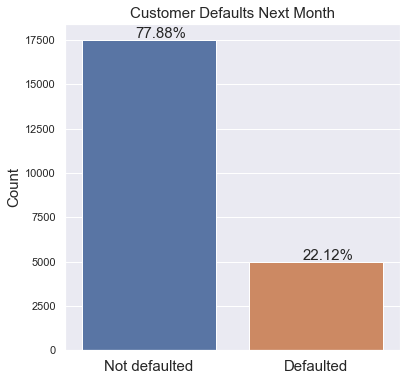

In [15]:
sns.set()
plt.figure(figsize=(6,6))
total = float(len(df))
counts = df["default.payment.next.month"].value_counts()
plt.title('Customer Defaults Next Month',
         fontsize=15)
ax = sns.barplot(x = counts.index, y = counts.values)
for p in ax.patches:
    percentage = '{:.2f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()/2.5
    y = p.get_height()+100
    ax.annotate(percentage, (x, y), fontsize=15)
locs, labels=plt.xticks()
new_xticks = ['Not defaulted', 'Defaulted']
plt.xticks(locs, new_xticks,fontsize=15)
plt.xlabel('')
plt.ylabel('Count', fontsize=15)
plt.show()

### Next we will look at the distribution of the Credit limit and Age variables.
#### From the graph below, we can see that the most common credit limit is near zero and the distribution is skewed right. The skewness is caused by a small amount of customers having very high credit limits.


Text(0, 0.5, 'Count')

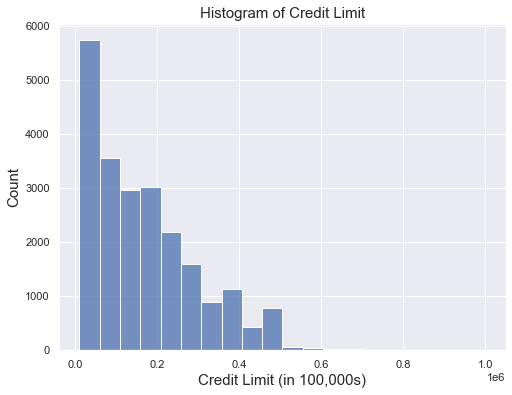

In [16]:
plt.figure(figsize=(8,6))
sns.histplot(x ="LIMIT_BAL",data = df,bins=20)
plt.title('Histogram of Credit Limit', fontsize=15)
plt.xlabel('Credit Limit (in 100,000s)', fontsize=15)
plt.ylabel('Count', fontsize=15)

Text(0, 0.5, 'Count')

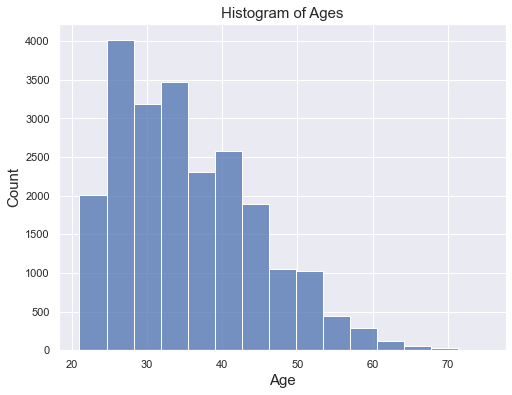

In [17]:
plt.figure(figsize=(8,6))
g=sns.histplot(x ="AGE",data = df,bins=15)
plt.title('Histogram of Ages', fontsize=15)
plt.xlabel('Age', fontsize=15)
plt.ylabel('Count', fontsize=15)

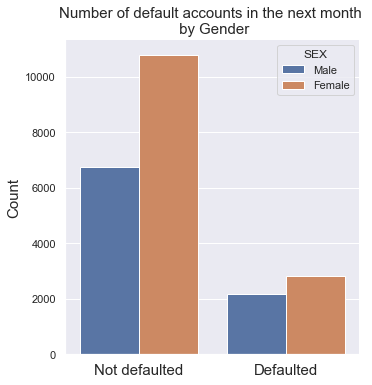

In [18]:
g=sns.catplot(x ="default.payment.next.month", hue='SEX', 
kind ="count",data = df,legend_out=False)
plt.title('Number of default accounts in the next month \n by Gender', fontsize=15)
locs, labels=plt.xticks()
new_xticks = ['Not defaulted', 'Defaulted']
plt.xticks(locs, new_xticks,fontsize=15)
plt.xlabel('')
plt.ylabel('Count', fontsize=15)
new_labels = ['Male', 'Female']
for t, l in zip(g._legend.texts, new_labels): t.set_text(l)

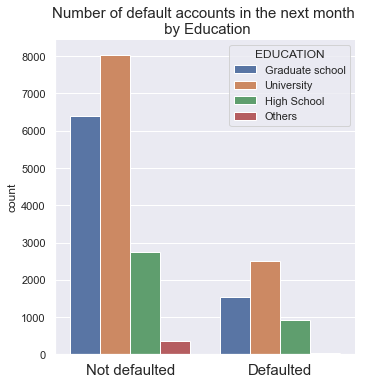

In [19]:
g=sns.catplot(x ="default.payment.next.month", hue='EDUCATION', 
kind ="count",data = df,legend_out=False)
plt.title('Number of default accounts in the next month \n by Education', fontsize=15)
locs, labels=plt.xticks()
new_xticks = ['Not defaulted', 'Defaulted']
plt.xticks(locs, new_xticks,fontsize=15)
plt.xlabel('')
new_labels = ['Graduate school','University','High School', 'Others']
for t, l in zip(g._legend.texts, new_labels): t.set_text(l)

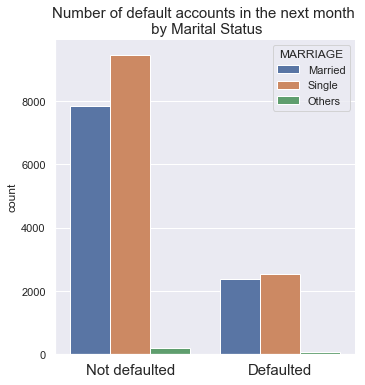

In [20]:
g=sns.catplot(x ="default.payment.next.month", hue='MARRIAGE', 
kind ="count",data = df,legend_out=False)
plt.title('Number of default accounts in the next month \n by Marital Status', fontsize=15)
locs, labels=plt.xticks()
new_xticks = ['Not defaulted', 'Defaulted']
plt.xticks(locs, new_xticks,fontsize=15)
plt.xlabel('')
new_labels = ['Married', 'Single', 'Others']
for t, l in zip(g._legend.texts, new_labels): t.set_text(l)

### Next we will take a look at histograms for the payment history variables (PAY_0, PAY_2, PAY_3, PAY_4, PAY_5, PAY_6). These features represent the payment status of the account in the past 6 months. From below, we can see that there are missing values for X=1 for the variables PAY_2, PAY_3, PAY_4, PAY_5, PAY_6. This is a problem that we will address later when we select features for the modeling process.

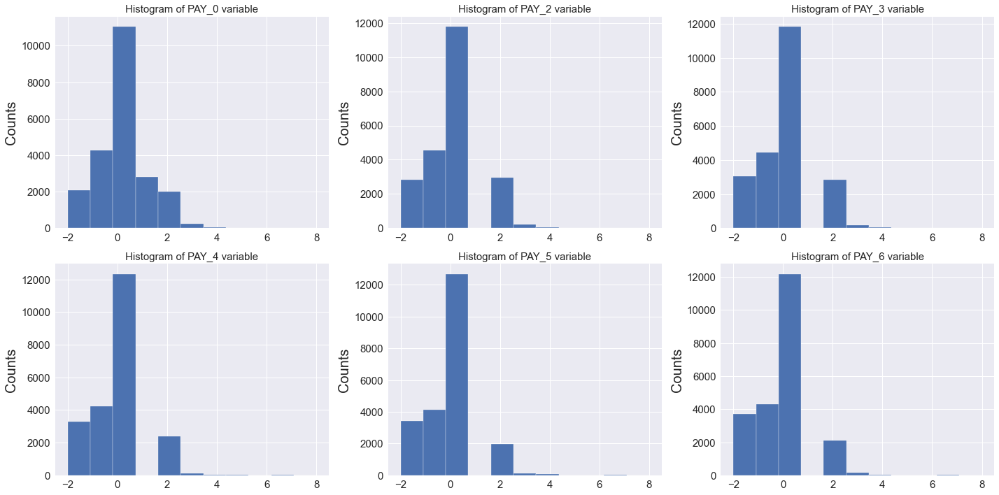

In [21]:
# set up the figure size
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 10)

# make subplots (2 rows and 2 columns)
fig, axes = plt.subplots(nrows = 2, ncols = 3)

# Specify the features of interest
# The pay status features are columns 6 through 11 inclusive
pay_features = df.columns[6:12]

# Use variables as x-axis labels and 'Counts' as y-axis labels
xaxes = pay_features
#yaxes = ['Counts', 'Counts', 'Counts', 'Counts', 'Counts', 'Counts']

# draw histograms
# we can then use enumerate on axes.
axes = axes.ravel()
for idx, ax in enumerate(axes):
    ax.hist(df[pay_features[idx]].dropna(), bins=11)
    ax.set_ylabel('Counts', fontsize=20)
    ax.tick_params(axis='both', labelsize=15)
    ax.set_title("Histogram of {} variable".format(xaxes[idx]),fontsize=15) 
    
plt.tight_layout()
plt.show()

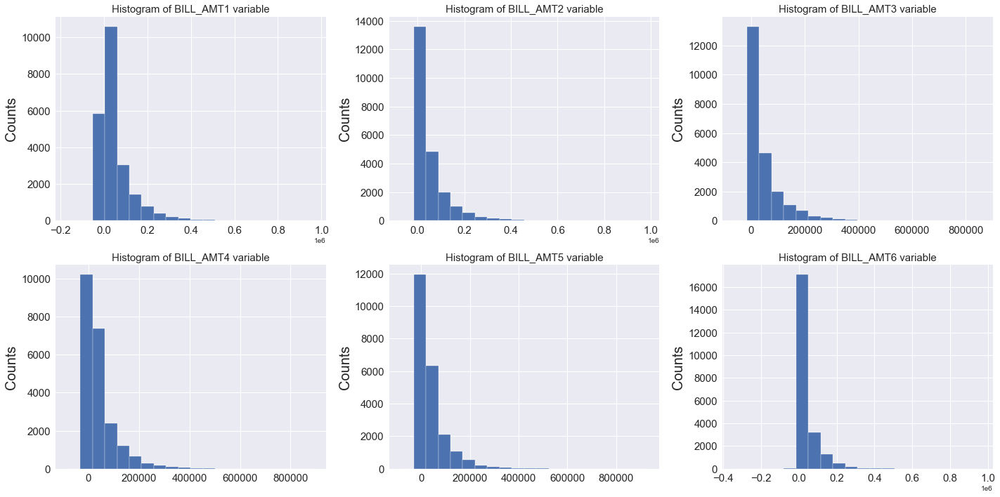

In [22]:
# set up the figure size
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 10)

# make subplots (2 rows and 2 columns)
fig, axes = plt.subplots(nrows = 2, ncols = 3)

# Specify the features of interest
# The bill amount features are columns 12 through 17 inclusive
bill_amt_features = df.columns[12:18]

# Use variables as x-axis labels and 'Counts' as y-axis labels
xaxes = bill_amt_features

# draw histograms
# ravel flattens out the 2x3 to a 1D array 
# we can then use enumerate on axes.
axes = axes.ravel()
for idx, ax in enumerate(axes):
    ax.hist(df[bill_amt_features[idx]].dropna(), bins=20)
    ax.set_ylabel('Counts', fontsize=20)
    ax.tick_params(axis='both', labelsize=15)
    ax.set_title("Histogram of {} variable".format(xaxes[idx]),fontsize=15) 
    
plt.tight_layout()
plt.show()

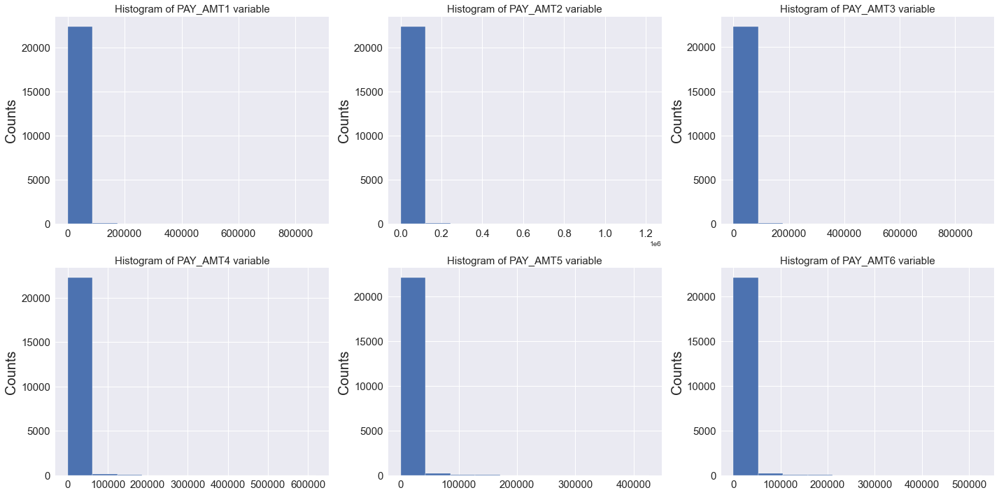

In [23]:
# set up the figure size
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 10)

# make subplots (2 rows and 2 columns)
fig, axes = plt.subplots(nrows = 2, ncols = 3)

# Specify the features of interest
# The pay amount features are columns 18 through 23 inclusive
pay_amt_features = df.columns[18:24]

# Use variables as x-axis labels and 'Counts' as y-axis labels
xaxes = pay_amt_features

# draw histograms
# ravel flattens out the 2x3 to a 1D array 
# we can then use enumerate on axes.
axes = axes.ravel()
for idx, ax in enumerate(axes):
    ax.hist(df[pay_amt_features[idx]], bins=10)
    ax.set_ylabel('Counts', fontsize=20)
    ax.tick_params(axis='both', labelsize=15)
    ax.set_title("Histogram of {} variable".format(xaxes[idx]),fontsize=15)
    
plt.tight_layout()
plt.show()

We can see from above that that the histograms are all grouped around zero. Let's take a look at the descriptive statistics for these variables.

In [24]:
df[pay_amt_features].describe()

,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
count,22500.000000,2.250000e+04,22500.000000,22500.000000,22500.000000,22500.000000
mean,5668.512711,5.913549e+03,5264.413600,4832.354844,4781.747156,5221.697600
std,16374.186672,2.045441e+04,17877.854557,15207.811671,15089.724717,17591.057895
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000
25%,1000.000000,8.542500e+02,390.000000,296.000000,245.750000,100.000000
50%,2121.000000,2.013000e+03,1812.000000,1500.000000,1501.000000,1500.000000
75%,5021.000000,5.000000e+03,4591.250000,4052.500000,4040.000000,4000.000000
max,873552.000000,1.215471e+06,896040.000000,621000.000000,426529.000000,527143.000000


### From above, we can see a huge variation between minimum payments and maximum payments, and this is skewing the histograms. We can adjust for this by plotting histograms of the log10 transformation for these variables. To do this we must first remove the zero values, because log(0) is undefined (negative infinity). 

In [25]:
# Find indexes where the variables = zero, and create a boolean mask
pay_zero = df[pay_amt_features] == 0

# Create a dataframe to filter out the values
# And then apply the log transformation
df2 = df[pay_amt_features][~pay_zero].apply(np.log10)

In [26]:
# Check the descriptive stats of the new dataframe
df2.describe()

,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
count,18606.000000,18463.000000,18026.000000,17691.000000,17449.000000,17082.000000
mean,3.489667,3.477010,3.406056,3.358082,3.375227,3.385860
std,0.536105,0.552498,0.587613,0.608235,0.582783,0.590847
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.204663,3.176959,3.079633,3.000000,3.000000,3.000000
50%,3.477121,3.477121,3.397940,3.350636,3.361728,3.380211
75%,3.779452,3.778151,3.728029,3.698970,3.699317,3.698970
max,5.941289,6.084745,5.952327,5.793092,5.629949,5.721928


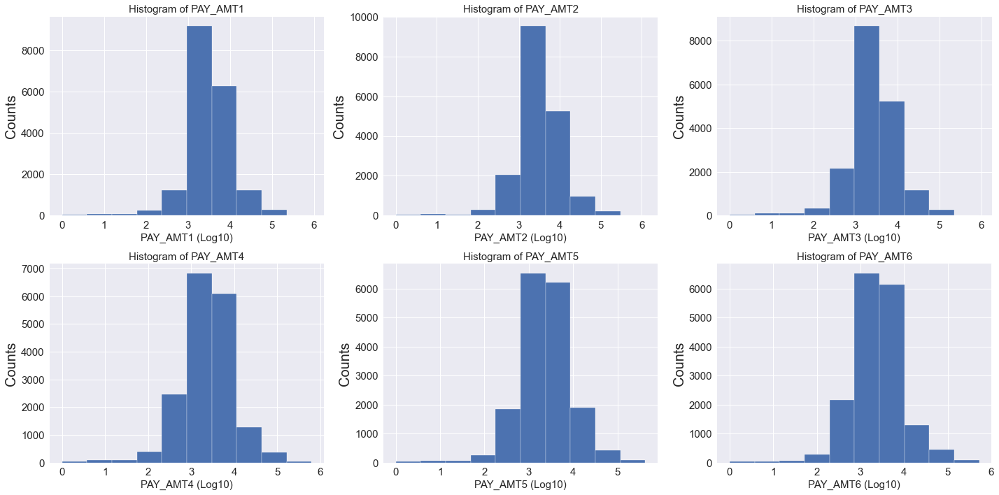

In [27]:
# set up the figure size
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 10)

# make subplots (2 rows and 2 columns)
fig, axes = plt.subplots(nrows = 2, ncols = 3)

# Specify the features of interest
# The pay amount features are columns 18 through 23 inclusive
pay_amt_features = df.columns[18:24]

# Use variables as x-axis labels and 'Counts' as y-axis labels
xaxes = pay_amt_features

# draw histograms
# ravel flattens out the 2x3 to a 1D array 
# we can then use enumerate on axes.
axes = axes.ravel()
for idx, ax in enumerate(axes):
    ax.hist(df2[pay_amt_features[idx]].dropna(), bins=10)
    ax.set_xlabel(xaxes[idx]+' (Log10)', fontsize=15)
    ax.set_ylabel('Counts', fontsize=20)
    ax.tick_params(axis='both', labelsize=15)
    ax.set_title("Histogram of {}".format(xaxes[idx]),fontsize=15)
    
plt.tight_layout()
plt.show()

Next, we will look at the heatmap of correlations.

Text(0.5, 1.0, 'Heatmap of Correlations')

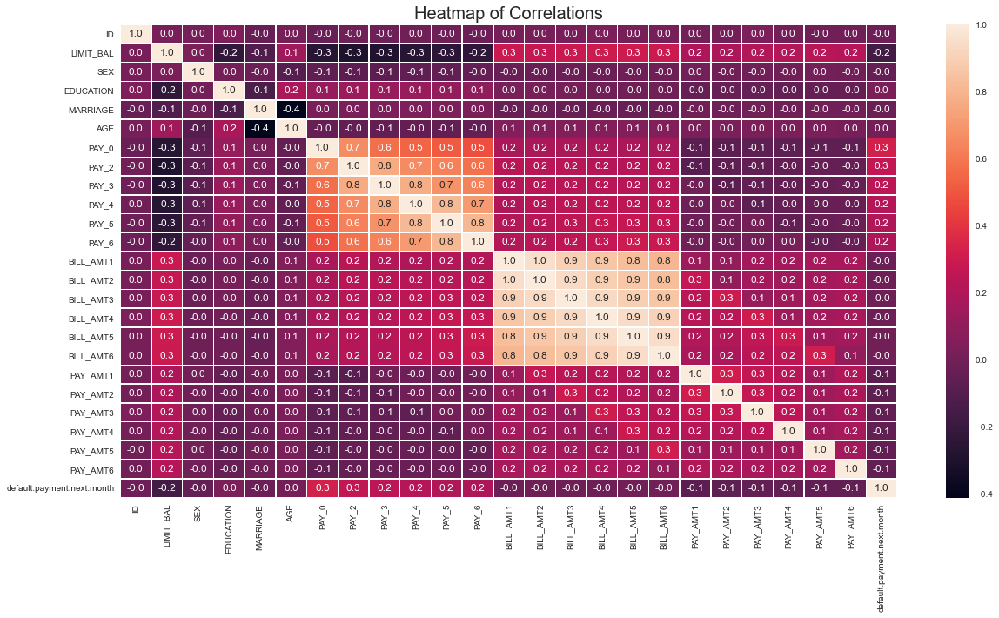

In [28]:
sns.heatmap(df.corr(), annot=True, linewidths=.5, fmt= '.1f')
plt.title('Heatmap of Correlations', fontsize=20)

We can see from above that PAY_0 has the highest correlation with our target variable. This makes sense because PAY_0 is the payment status for the most recent month. From above we can also see strong correlations between the BILL_AMT features. This makes sense because if a customer doesn't pay down their balances, they carry over across the BILL_AMT variables. The PAY_0 through PAY_6 variables are highly correlated because customers that are paying late generally continue paying late as time goes on, especially as late fees and interest add up. Customers paying on time will continuing paying on time until they become late and then likely continue to pay late. Next, we will inspect the ECDF of PAY_0 to compare customers that will default or not default next month. 

Text(0.5, 1.0, 'ECDF of Most recent month Payment Status')

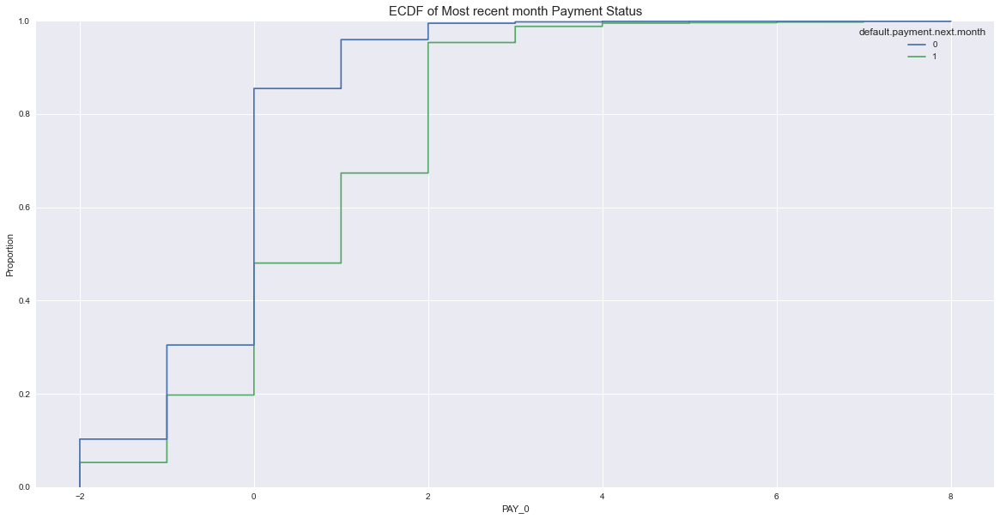

In [29]:
sns.ecdfplot(data=df, x="PAY_0", hue="default.payment.next.month")
plt.title('ECDF of Most recent month Payment Status',fontsize=15)

From above, we can see that about 50% of the accounts that defaulted had accounts in good standing (PAY_0 <= 0) the month before. We can infer that about 15% of accounts that defaulted had payments delayed by 1 month, and about 30% were delayed by 2 months. This is in contrast to customers the did not default, which had 85% of their accounts in good standing (PAY_0 <= 0).

Text(0.5, 1.0, 'ECDF of Account limit balance')

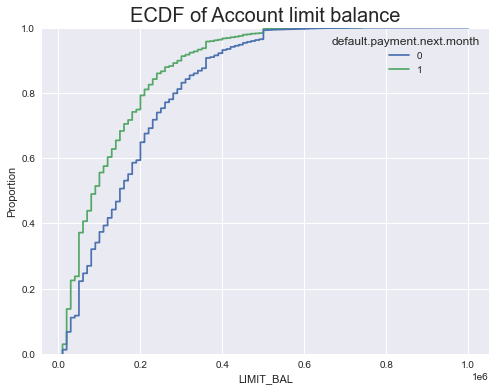

In [30]:
plt.figure(figsize=(8, 6))
sns.ecdfplot(data=df, x="LIMIT_BAL", hue="default.payment.next.month")
plt.title('ECDF of Account limit balance',fontsize=20)

From above, you can see that people that defaulted had a lower LIMIT_BAL than people that didn't default, and this was across the entire distribution. The defaulted account holders were likely given a lower account limit due to having a lower credit score at the time the account was opened. This makes sense that banks would extend lower amounts of credit to people they deem more likely to default, thereby reducing their exposure when a default does occur. From this analysis, the LIMIT_BAL is likely an important feature in the model. We will examine this more in the later steps.

We saw the histograms of the PAY_2, PAY_3, PAY_4, PAY_5, and PAY_6 variables had almost no counts for payment status=1 (payment is 1 month late). However, all of the variables, including the PAY_0 variable had over 2,000 counts for payment status=2 (payment is 2 months late). This is troublesome, as the data does not to carry over appropriately across PAY_2, PAY_3, PAY_4, PAY_5, and PAY_6. Since PAY_0 has the most complete and recent information, we will be keeping it and ***dropping the PAY_2, PAY_3, PAY_4, PAY_5, and PAY_6 features. We will also drop the ID variable.*** From our proposal, we want to determine what variables contribute to a customer default in the next month. ***Since banks are not allowed to use gender to determine creditworthiness, we will also drop the SEX variable from this analysis.*** We will drop these columns from X and then create a new train and test set using the same random_state as before. 

In [31]:
# Specify X to be the feature columns only, and y to be the target column
# We are dropping 'ID','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6'
X = df.drop(['SEX','ID','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','default.payment.next.month'], axis=1)

# Specify y to be the target column
y = df['default.payment.next.month']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    train_size=0.75,
                                                    random_state=42,
                                                    stratify=y)

In [32]:
X.shape

(22500, 17)

### ***Part 2 - Feature Selection.*** Next, we will examine several methods for feature selection.

### Univariate Feature Selection.  
We are trying to predict the response variable. This means that we are predicting whether or not the customer will default on their next month's payment. We will now use an F-test to examine the individual relationship between each feature and the response variable. Since this is a classification problem, we will use the f_classif function from sklearn. This function will perform an analysis of variance, or ANOVA F-test. For each feature, we will calculate the F statistic and associated p-value. For a given F-statistic, the p-value shows, for the samples in the positive class, how likely is it that the average value of this feature is the same as that of samples in the negative class? If the averages are different between the two classes and the p-value is small, then there likely is useful information that can be learned by selecting that feature to be included in the model.

In [33]:
# Import the f_classif function
from sklearn.feature_selection import f_classif

# We have already split the data into X_train and y_train, so we will use those as parameters
[f_stat, f_p_value] = f_classif(X_train, y_train)

In [34]:
f_test_df = pd.DataFrame({'Feature':X_train.columns,
                          'F statistic':f_stat,
                          'p value':f_p_value})

print('The top 15 features sorted by p value:')
f_test_df.sort_values('p value')[:15]

The top 15 features sorted by p value:


,Feature,F statistic,p value
4,PAY_0,2061.288108,0.000000e+00
0,LIMIT_BAL,483.370681,1.196121e-105
11,PAY_AMT1,84.762774,3.749854e-20
12,PAY_AMT2,71.245702,3.406730e-17
15,PAY_AMT5,55.423338,1.018562e-13
16,PAY_AMT6,54.463034,1.657656e-13
14,PAY_AMT4,53.900631,2.204946e-13
13,PAY_AMT3,51.579157,7.163519e-13
1,EDUCATION,23.752707,1.105364e-06
5,BILL_AMT1,11.221271,8.104229e-04


In the datframe above, the features with the smallest p-values are shown, which indicates that the average values of these features between the positive and negative classes are significantly different. Therefore it is likely that these features will help predict which class a sample belongs to. We had previously shown that PAY_0 (via correlation to the response varialbe, and being a lagging instance of the response variable) was likely an important feature. We had also previously shown that LIMIT_BAL (via the ECDF graph) was also likely an important feature. The appearance of PAY_0 and LIMIT_BAL at the top of the F-test confirms our previous assumptions.

## Feature Selection using Logistic Regression.  
We will check the coefficients returned from fitting a Logistic Regression model with different hyperparameters. The variables with the largest absolute value of coefficients have the greatest influence in the model.

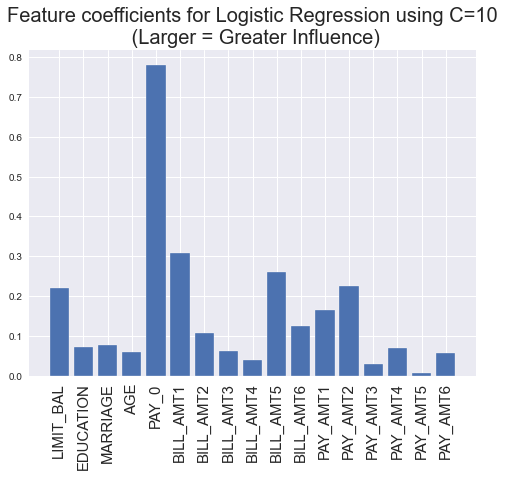

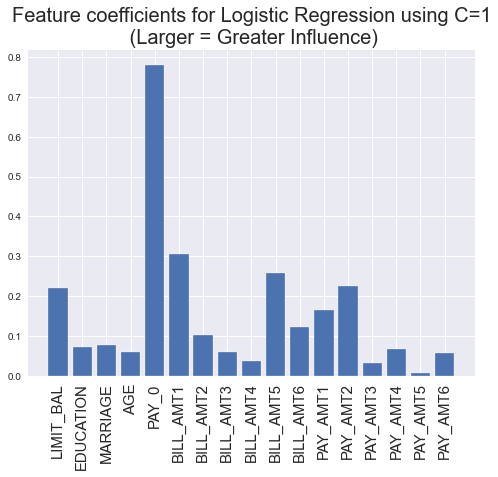

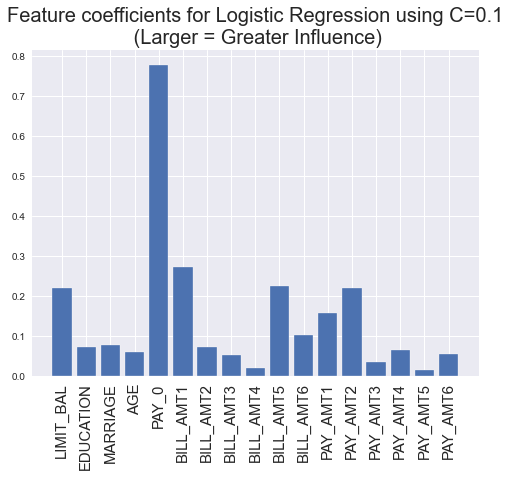

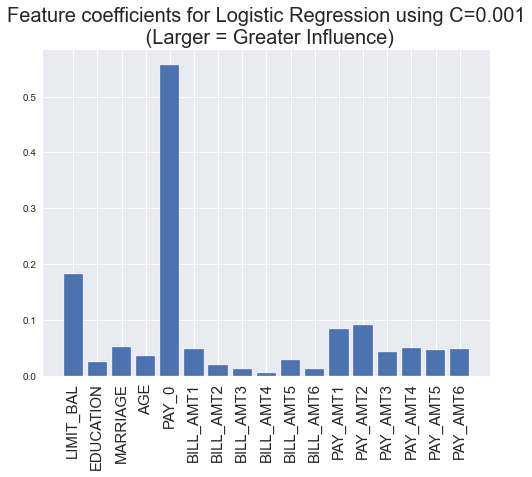

In [35]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

# Initiate the scaler
scaler = StandardScaler()

# Fit and transform the X_train data
X_train_std = scaler.fit_transform(X_train)

# Apply the scaler that was fit to the X_train data to the X_test data
X_test_std = scaler.transform(X_test)

# Set the hyperparameters
C = [10, 1, .1, .001]

for c in C:
    clf = LogisticRegression(penalty='l2', C=c, max_iter=10000)
    clf.fit(X_train_std, y_train)
    D=dict(zip(X_train.columns, abs(clf.coef_[0])))
    plt.figure(figsize=(8, 6))
    plt.bar(range(len(D)), list(D.values()), align='center')
    plt.xticks(range(len(D)), list(D.keys()), fontsize=15,rotation=90)
    plt.title('Feature coefficients for Logistic Regression using C='+ str(c) +'\n (Larger = Greater Influence)', fontsize=20)
    plt.show()
    print('')

From the above graphs, we can see that PAY_0, BILL_AMT1, LIMIT_BAL, PAY_AMT1, and PAY_AMT2 have the largest coefficients in all four graphs. This is similar to the results we obtained from the previous univariate feature selection, with the exception of BILL_AMT1, which ranked 10th in the Univariate scoring, but 5th here. This discrepance is likely because univariate feature selection does not consider the interactions between features. 

### Feature selection using a random forest.  
A random forest classifier is an ensemble model of decision trees. The ensemble model passes a different, random subset of features to a number of decision trees. The random forest classifier has a feature_importances_ attribute that assigns coefficients to each feature. Like in the previous Logistic Regression example, the features with the highest coefficients are the most important to the model. Note: We have not yet tuned any of the hyperparameters for the random forest. We can view the most important best features by calling the .feature_importances_ on the model and graphing the results.

Feature: 4, Score: 0.14788
Feature: 3, Score: 0.07109
Feature: 0, Score: 0.06845
Feature: 5, Score: 0.06787
Feature: 6, Score: 0.06218
Feature: 11, Score: 0.05962
Feature: 12, Score: 0.05822
Feature: 10, Score: 0.05771
Feature: 7, Score: 0.05737
Feature: 8, Score: 0.05648
Feature: 9, Score: 0.05635
Feature: 13, Score: 0.05343
Feature: 16, Score: 0.05097
Feature: 14, Score: 0.04937
Feature: 15, Score: 0.04850
Feature: 1, Score: 0.02046
Feature: 2, Score: 0.01405


<Figure size 864x648 with 0 Axes>

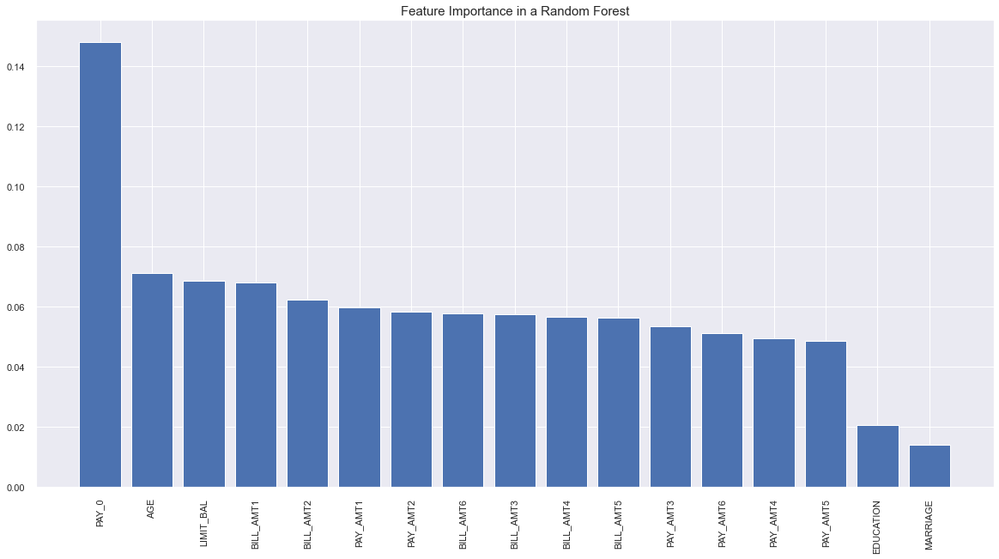

In [36]:
sns.set()
plt.figure(figsize=(12,9))
from sklearn.ensemble import RandomForestClassifier
# Instantiate the model
model = RandomForestClassifier()

# fit the model
model.fit(X_train, y_train)

# get importance
importances = model.feature_importances_

# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

for i,v in zip(indices, importances[indices]):
	print('Feature: %0d, Score: %.5f' % (i,v))
    
# Rearrange feature names so they match the sorted feature importances
names = [X.columns[i] for i in indices]

# Create plot
plt.figure()

# Create plot title
plt.title("Feature Importance in a Random Forest", fontsize=15)

# Add bars
plt.bar(range(X.shape[1]), importances[indices])

# Add feature names as x-axis labels
plt.xticks(range(X.shape[1]), names, rotation=90)

# Show plot
plt.show()


### 8 of the top 12 features were also considered important by the logistic regression model.

## Using PCA to determine the appropriate number of components.

In [37]:
from sklearn.decomposition import PCA

# Create the standard scaler object and fit and transfor to training data
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)

In [38]:
# Set the number of current variables
pca = PCA(n_components = 17)
pca.fit(X_train_std)
# Apply the scaler that was fit to the X_train data to the X_test data
X_test_std = scaler.transform(X_test)

PCA(copy=True, iterated_power='auto', n_components=17, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

## It will give eigen values
pca.explained_variance_ratio_

array([0.34968473, 0.11910505, 0.08866549, 0.06971234, 0.0535973 ,
       0.05141108, 0.04872037, 0.04654816, 0.04276949, 0.03964719,
       0.03453013, 0.03081735, 0.01532753, 0.0042631 , 0.00233078,
       0.00157694, 0.00129298])

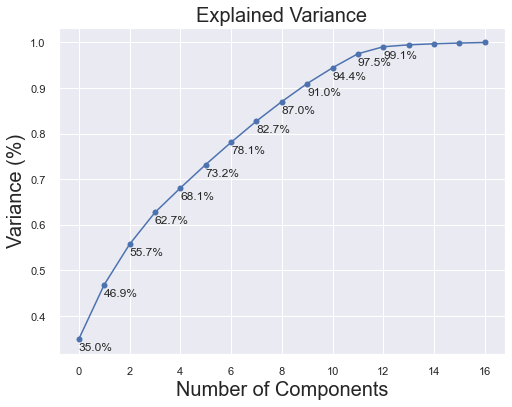

In [39]:
plt.figure(figsize=(8, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_),marker='o')
plt.xlabel('Number of Components', fontsize=20)
plt.ylabel('Variance (%)', fontsize=20)
for x, y in zip(range(len(pca.explained_variance_ratio_)-4), np.cumsum(pca.explained_variance_ratio_)):
    plt.text(x, y-.025,s = '{:.1f}'.format(y*100)+'%')
plt.title('Explained Variance', fontsize=20)
plt.show()

#### From the above graph above, we can see that 94.5% of the variance can be explained if we use 10 components, and 99.1% of the variance can be explained if we use 12 components. 

### **Final feature selection.**
#### We will be dropping the following variables before building models:
**'ID'** - Dropped due to containing only unique values.  
**'SEX'** - Dropped due to creditworthiness not being determined by gender.  
**'PAY_2','PAY_3','PAY_4','PAY_5','PAY_6'** - Dropped due to missing values.  
**'BILL_AMT2', 'BILL_AMT3','BILL_AMT4','BILL_AMT5'** - Dropped due to high correlation with BILL_AMT1 variable.  
**'EDUCATION', 'MARRIAGE'** - Dropped due to low feature importance.

### **Part 3 - Model Evaluation and Selection.** We have already split the data into training and testing. As a reminder, we are trying to predict the accounts that will default next month. We have also previously used a standard scaler to scale the data, but we need to redefine our X data to account for the variable changes. We will then create new training and testing sets and rescale the data.

In [40]:
# Specify X to be the feature columns only, and y to be the target column

X = data.drop(['SEX','ID','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6',
                 'EDUCATION', 'MARRIAGE',
                 'BILL_AMT2', 'BILL_AMT3',
                 'BILL_AMT4','BILL_AMT5',
                 'default.payment.next.month'], axis=1)

# Specify y to be the target column
y = data['default.payment.next.month']

# Create the train and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    train_size=0.75,
                                                    random_state=42,
                                                    stratify=y)

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

# Initiate the scaler
scaler = StandardScaler()

# Fit and transform the X_train data
X_train_std = scaler.fit_transform(X_train)

# Apply the scaler that was fit to the X_train data to the X_test data
X_test_std = scaler.transform(X_test)

In [41]:
y.value_counts(normalize=True)

0    0.7788
1    0.2212
Name: default.payment.next.month, dtype: float64

### Before we move on to model evaluation and selection, we will graph the feature importances for our selected features.

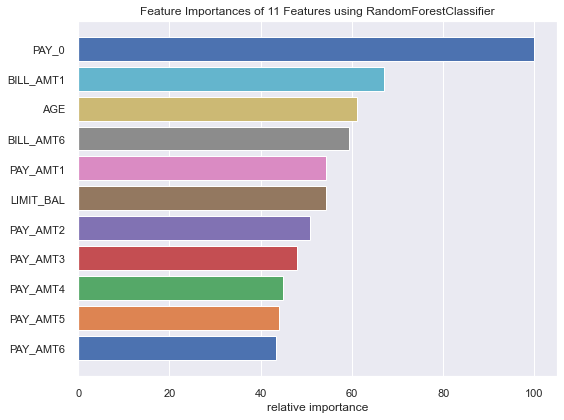

In [43]:
sns.set()
plt.figure(figsize=(8, 6))
from yellowbrick.model_selection import FeatureImportances
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()
model.fit(X_train_std, y_train)
visualizer = FeatureImportances(model)
visualizer.fit(X_train, y_train)
visualizer.show();

#### Now let's look at the performance of an unconfigured Logistic Regression Model without standardizing the input features. We are trying to predict if a customer will default on ther account next month. We previously saw that there is a class imbalance of 77.88% of account non-defaults next month to 22.12% accounts that will default next month. This means that a model that always picks customers not to default next month will be accurate 77.88% of the time. This gives us a baseline performance that we need to exceed. As our first model, we will build a Logistic Regression model *without applying scaling to the features*. We expect the baseline model to perform poorly without scaling features.

                    Accuracy score for the baseline Logistic Regression model=77.88%



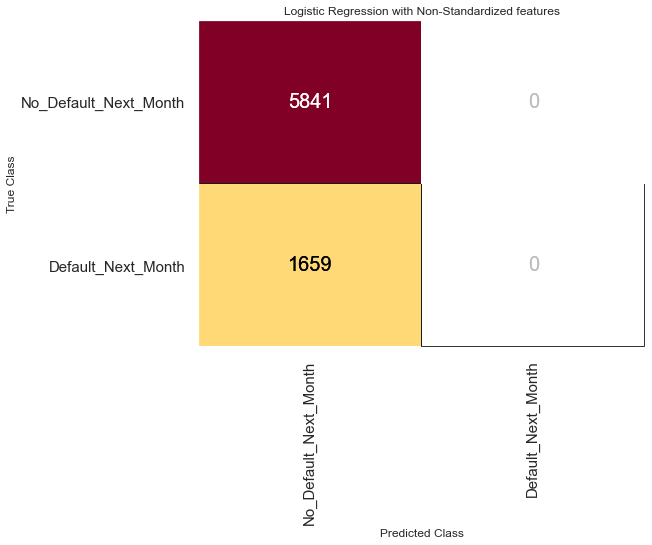

In [44]:
from yellowbrick.classifier import ConfusionMatrix
from yellowbrick.classifier import ClassificationReport
from yellowbrick.classifier import ROCAUC


# Instantiate a logistic regression model
baseline_log_model = LogisticRegression(max_iter=1000)

plt.rcParams['figure.figsize'] = (8, 6)
plt.rcParams['font.size'] = 15

#The ConfusionMatrix visualizer taxes a model
classes = ['No_Default_Next_Month','Default_Next_Month']

cm = ConfusionMatrix(baseline_log_model,
                     classes=classes,
                     percent=False,title="Logistic Regression with Non-Standardized features")

#Fit fits the passed model. This is unnecessary if you pass the visualizer a pre-fitted model
cm.fit(X_train, y_train)

#To create the ConfusionMatrix, we need some test data. Score runs predict() on the data
#and then creates the confusion_matrix from scikit learn.
cm.score(X_test, y_test)

# change fontsize of the labels in the figure
for label in cm.ax.texts:
    label.set_size(20)

#Visualize the confusion matrix
accuracy_score = str(round(cm.score(X_test, y_test)*100,2))+'%'
print(' '*20 + 'Accuracy score for the baseline Logistic Regression model=' + accuracy_score)
print('')
    
# change fontsize of the labels in the figure
for label in cm.ax.texts:
    label.set_size(20)
cm.poof();

### From above, we can see that the accuracy score is 77.88%. We also see that the baseline model never predicts accounts that default next month, so the model is no better than simply always choosing the majority class. We will not print a classification report, as this model is worthless.

### We will be evaluating several models by visualizing a confusion matrix, classification report, and ROCAUC curves. To streamline this process, we will create functions for each of these visualizations. We will then call these functions to evaluate each model's performance.

In [45]:
# Define a function to visualize a confusion matrix for a given model.
def visualize_conf_matrix(model,title):
    
    '''This function takes a model and model title as input,
        and uses yellowbrick to output a plot of the confusion matrix.'''
    plt.rcParams['figure.figsize'] = (8, 6)
    plt.rcParams['font.size'] = 15

    #The ConfusionMatrix visualizer taxes a model
    classes = ['No_Default_Next_Month','Default_Next_Month']

    conf_matrix = ConfusionMatrix(model=model,
                                  classes=classes,
                                  percent=False,
                                  title=title+ ' Confusion Matrix')

    #Fit fits the passed model. This is unnecessary if you pass the visualizer a pre-fitted model
    conf_matrix.fit(X_train_std, y_train)

    #To create the ConfusionMatrix, we need some test data. Score runs predict() on the data
    #and then creates the confusion_matrix from scikit learn.
    conf_matrix.score(X_test_std, y_test)

    #Visualize the confusion matrix
    accuracy_score = str(round(conf_matrix.score(X_test_std, y_test)*100,2))+'%'
    print(' '*24 + 'Accuracy score for the ' + title + '= ' + accuracy_score)
    print('')
    
    # change fontsize of the labels in the figure
    for label in conf_matrix.ax.texts:
        label.set_size(20)
    
    conf_matrix.poof()
    
# Define a function to visualize a classification report for a given model.
def visualize_class_report(model, title):
    '''This function takes a model and model title as input,
        and uses yellowbrick to output a plot of the classification report.
        This includes the Precision, Recall, and F1 Scores'''
     
    classes = ['No_Default_Next_Month','Default_Next_Month']

    plt.rcParams['font.size'] = 20
    
    # Instantiate the visualizer
    visualizer = ClassificationReport(model=model,
                                  classes=classes,
                                  title=title+" Precision, Recall, and F1 Scores",
                                      cmap='YlOrRd',
                                     fig=plt.figure(figsize=(10,7)))

    visualizer.fit(X_train_std, y_train)  # Fit the training data to the visualizer
    visualizer.score(X_test_std, y_test)  # Evaluate the model on the test data
    
 
    # change fontsize of the labels in the figure
    for label in visualizer.ax.texts:
        label.set_size(20)
    
    visualizer.show();
    

# Define a function to visualize ROCAUC curves for a given model.   
def visualize_ROCAUC(model, title):
    '''This function takes a model and model title as input,
    and uses yellowbrick to output a plot of the ROC Curve.
    This includes the Precision, Recall, and F1 Scores'''
    
    classes = ['No_Default_Next_Month','Default_Next_Month']

    plt.rcParams['figure.figsize'] = (10, 7)
    visualizer = ROCAUC(model=model,classes=classes,title='ROC Curve for '+ title)

    visualizer.fit(X_train_std, y_train)  # Fit the training data to the visualizer
    visualizer.score(X_test_std, y_test)  # Evaluate the model on the test data
    visualizer.poof();
    return visualizer.score(X_test_std, y_test)

### Next, we will look at tuning a logistic regression model using GridSearchCV and the scaled features. We will choose the model with best scoring accuracy.

In [46]:
# example of grid searching key hyperparametres for logistic regression
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV

# Instantiate the LR model and the parameters to tune
model = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01,.001]

# define grid search and use the standardized features
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=10, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train_std, y_train)

# summarize results
print("Best result for Logistic Regression: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best result for Logistic Regression: 0.811693 using {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.811689 (0.005214) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.811693 (0.005215) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.811689 (0.005214) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.811684 (0.005213) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.811689 (0.005214) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.811689 (0.005214) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.811671 (0.005210) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.811671 (0.005210) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.811671 (0.005211) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.811484 (0.005201) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.811484 (0.005199) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.811587 (0.005163) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinea

### Now that we have found optimal hyperparameters, we will create a new tuned logistic regression model using the following hyperparameters: (C=100, penalty='l2', solver='lbfgs'). We are also using the standard scaled features. Next, we will visualize the confusion matrix.

                        Accuracy score for the Tuned Logistic Regression model= 81.35%



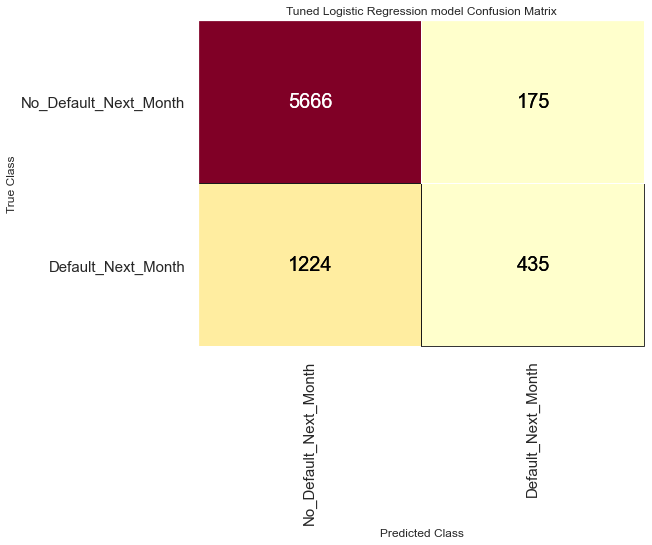

In [47]:
# Instantiate a logistic regression model with the optimized hyperparameters
tuned_log_model = LogisticRegression(max_iter=10000,
                                     C=100,
                                     penalty='l2',
                                     solver='lbfgs',
                                    random_state=42)

# Visualize the confusion matrix
visualize_conf_matrix(tuned_log_model, 'Tuned Logistic Regression model')

### We see that the accuracy improved slightly from 78.8% to 81.35%. Additionally, we can also see from the confusion matrix that the tuned model has successfully predicted 435 accounts that default next month. Next we will visualize the Precision, Recall and F-1 scores.

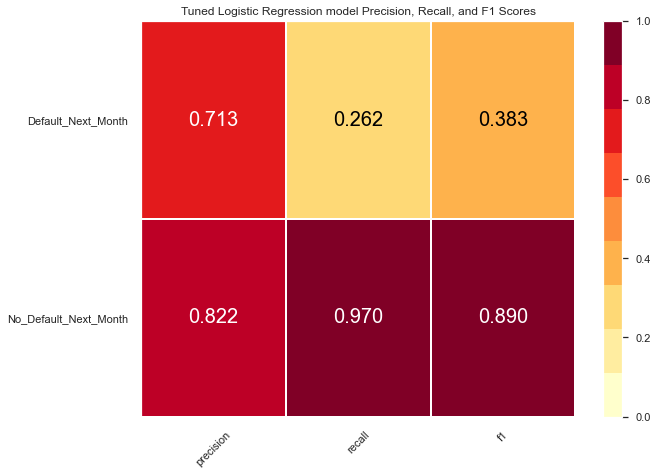

In [48]:
# Visualize the classification report
visualize_class_report(tuned_log_model, 'Tuned Logistic Regression model')

### We will plot the ROC curves next, which show the true positive rate on the Y axis, and false positive rate on the X axis. This means that the top left corner of the plot is the “ideal” point - a false positive rate of zero, and a true positive rate of one. A larger area under the curve is better. 

### The “steepness” of ROC curves is also important, since it is ideal to maximize the true positive rate while minimizing the false positive rate. Next, we will visualize the ROC Curve.

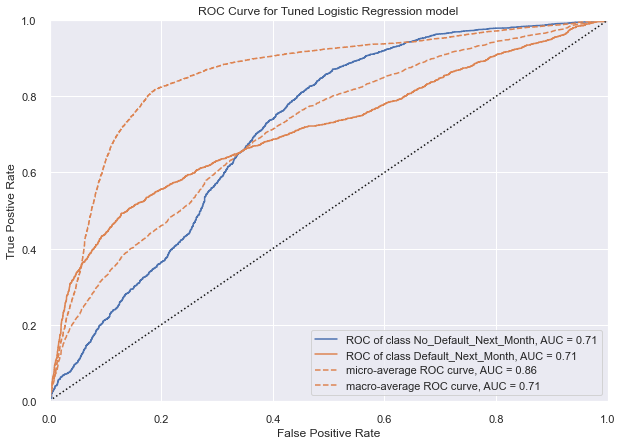

In [49]:
# Visualize the ROC Curve
roc_scores_list = list()
roc_score = visualize_ROCAUC(tuned_log_model, 'Tuned Logistic Regression model')
roc_scores_list.append(roc_score)

### We saw from the above results that the tuned Logististic Regression Model had low F1 and recall scores for predicting accounts that will default. Next, we will try tuning a Ridge classifier to see if we can do better. 

In [50]:
# example of grid searching key hyperparametres for ridge classifier
from sklearn.linear_model import RidgeClassifier
# define dataset
model = RidgeClassifier()
alpha = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
# define grid search
grid = dict(alpha=alpha)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train_std, y_train)
# summarize results
print("Best result for Ridge Classifier: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best result for Ridge Classifier: 0.791081 using {'alpha': 0.1}
0.791081 (0.004207) with: {'alpha': 0.1}
0.791081 (0.004207) with: {'alpha': 0.2}
0.791081 (0.004207) with: {'alpha': 0.3}
0.791081 (0.004207) with: {'alpha': 0.4}
0.791081 (0.004207) with: {'alpha': 0.5}
0.791081 (0.004207) with: {'alpha': 0.6}
0.791081 (0.004207) with: {'alpha': 0.7}
0.791081 (0.004207) with: {'alpha': 0.8}
0.791081 (0.004207) with: {'alpha': 0.9}
0.791081 (0.004207) with: {'alpha': 1.0}


### From above, we see that the scores from Ridge Classifier are lower than the tuned Logistic Regression model. The testing scores will likely be lower as well, so we will not be using this model. Next, we will tune a K nearest neighbor classifier.

In [51]:
# example of grid searching key hyperparametres for KNeighborsClassifier
from sklearn.neighbors import KNeighborsClassifier
# define dataset
model = KNeighborsClassifier()
n_neighbors = range(3, 21, 2)
weights = ['uniform', 'distance']
metric = ['euclidean', 'manhattan', 'minkowski']
# define grid search
grid = dict(n_neighbors=n_neighbors,weights=weights,metric=metric)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train_std, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.813615 using {'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'uniform'}
0.776207 (0.007985) with: {'metric': 'euclidean', 'n_neighbors': 3, 'weights': 'uniform'}
0.774519 (0.008716) with: {'metric': 'euclidean', 'n_neighbors': 3, 'weights': 'distance'}
0.792459 (0.007373) with: {'metric': 'euclidean', 'n_neighbors': 5, 'weights': 'uniform'}
0.791274 (0.007638) with: {'metric': 'euclidean', 'n_neighbors': 5, 'weights': 'distance'}
0.800044 (0.007420) with: {'metric': 'euclidean', 'n_neighbors': 7, 'weights': 'uniform'}
0.799022 (0.007988) with: {'metric': 'euclidean', 'n_neighbors': 7, 'weights': 'distance'}
0.806548 (0.006614) with: {'metric': 'euclidean', 'n_neighbors': 9, 'weights': 'uniform'}
0.804815 (0.007295) with: {'metric': 'euclidean', 'n_neighbors': 9, 'weights': 'distance'}
0.808000 (0.007152) with: {'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'uniform'}
0.806726 (0.006752) with: {'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'distance'}
0.81016

### Now that we have found optimal hyperparameters, we will create a new knn classification model using the following hyperparameters. (metric='manhattan', n_neighbors= 19, weights= 'uniform'). Next, we will visualize the confusion matrix.

                        Accuracy score for the KNN classifier model= 81.04%



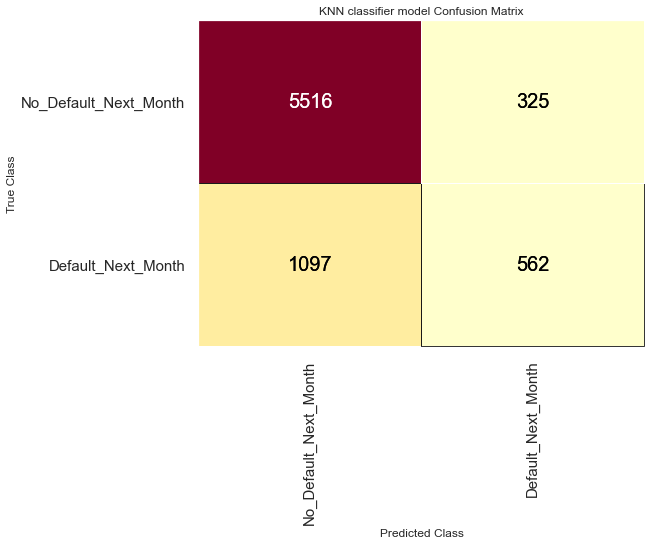

In [52]:
# Instantiate a KNN model with the optimized hyperparameters
knn_model = KNeighborsClassifier(metric='manhattan',
                                 n_neighbors= 19,
                                 weights= 'uniform')

# Visualize the confusion matrix
visualize_conf_matrix(knn_model, 'KNN classifier model')

### We see that the accuracy over baseline improved from 78.8% to 81.04%, but was slightly less than the 81.35% accuracy of the Logistic regression classifier. Additionally, we can also see from the confusion matrix that the tuned model has successfully predicted 562 accounts that default next month. Next we will visualize the Precision, Recall and F-1 scores.

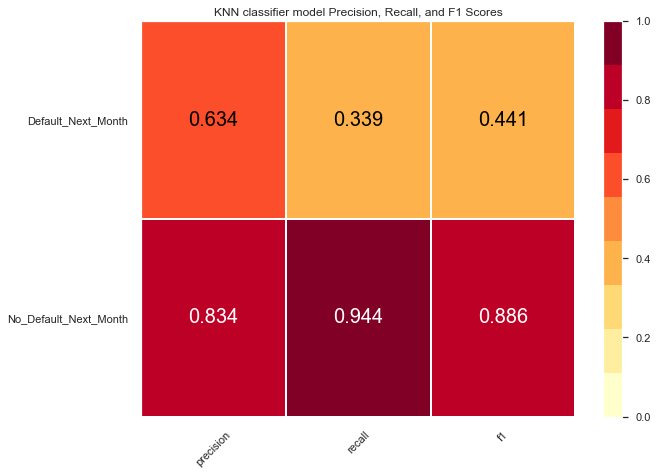

In [53]:
# Visualize the classification report
visualize_class_report(knn_model, 'KNN classifier model')

### The Recall and F1 scores show that the knn classifier is more skilled than the tuned Logistic Regressioon model at predicting accounts that will default next month. Next we will visualize the ROC curves. We can see from below that the ROCAUC (0.73) for the knn classifier is higher than the ROCAUC (0.71) for the tuned Logistic regression classifier. 

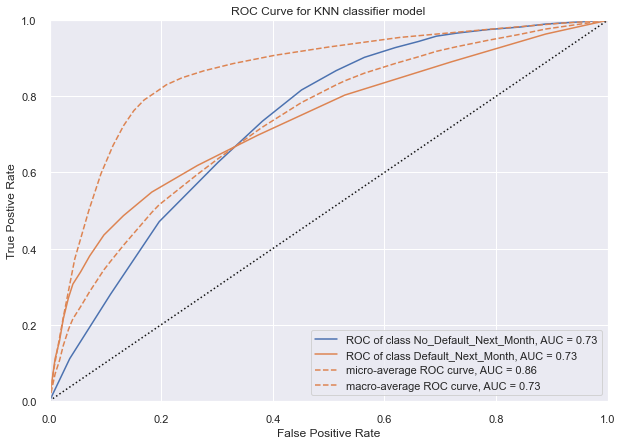

In [54]:
# Visualize the ROC Curve
roc_score = visualize_ROCAUC(knn_model, 'KNN classifier model')
roc_scores_list.append(roc_score)

### Next, we will tune a Bagging Classifier to see if we can do better. 

In [55]:
# example of grid searching key hyperparameters for BaggingClassifier
from sklearn.ensemble import BaggingClassifier
model = BaggingClassifier()
n_estimators = [10, 100, 1000]

# define grid search
grid = dict(n_estimators=n_estimators)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train_std, y_train)

# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.816311 using {'n_estimators': 1000}
0.805170 (0.006802) with: {'n_estimators': 10}
0.814993 (0.005880) with: {'n_estimators': 100}
0.816311 (0.007212) with: {'n_estimators': 1000}


### Now that we have found optimal hyperparameters, we will create a BaggingClassifier model using the following hyperparameters. (n_estimators=1000). Next, we will visualize the confusion matrix.

                        Accuracy score for the Bagging Classifier model= 81.07%



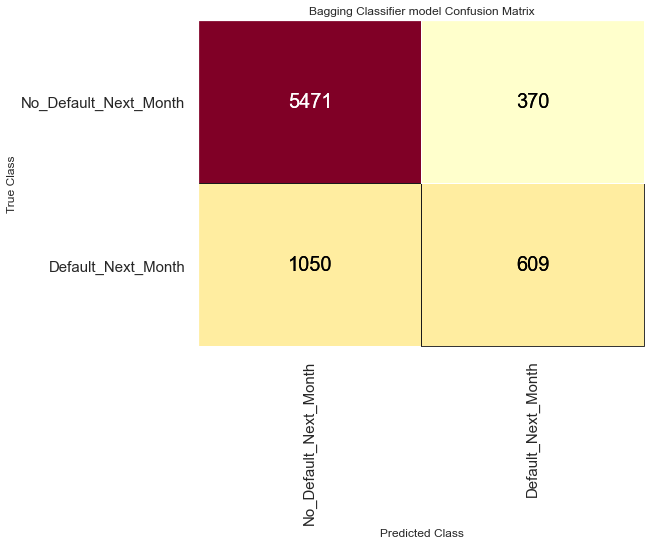

In [56]:
# Instantiate a bagging model with the optimized hyperparameters
bagging_model = BaggingClassifier(n_estimators=1000,
                                 random_state=42)

# Visualize the confusion matrix
visualize_conf_matrix(bagging_model, 'Bagging Classifier model')

### We see that the accuracy over baseline improved from 78.8% to 81.07%, but it is lower than the 81.48% accuracy of the Logistic regression classifier. From the confusion matrix, we see that bagging model successfully predicted 609 accounts that will default next month. Next we will visualize the Precision, Recall and F-1 scores.

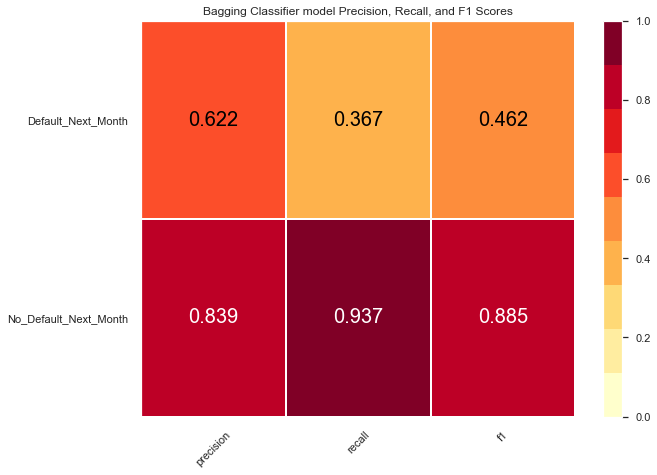

In [57]:
# Visualize the classification report
visualize_class_report(bagging_model, 'Bagging Classifier model')

### The Recall and F1 scores show that the bagging classifier is more skilled than the tuned logistic regression model at predicting accounts that will default next month. Next we will look at the ROC curves. Looking at the below graph, the ROCAUC (0.74) for the bagging classifier is higher than both the ROCAUC of the knn classifier (0.73) and Logistic regression classifier (0.71). 

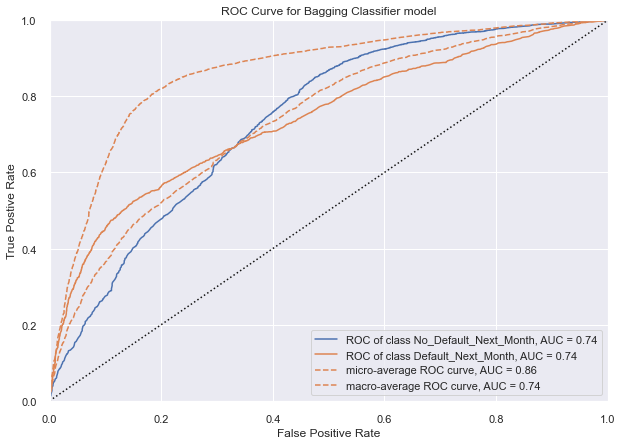

In [58]:
# Visualize the ROC Curve
roc_score = visualize_ROCAUC(bagging_model, 'Bagging Classifier model')
roc_scores_list.append(roc_score)

### Next, we will tune an AdaBoost classifier to see if we can improve performance. 

In [59]:
from sklearn.ensemble import AdaBoostClassifier
model = AdaBoostClassifier()
# define the grid of values to search
grid = dict()
grid['n_estimators'] = [10, 50, 100, 500]
grid['learning_rate'] = [0.0001, 0.001, 0.01, 0.1, 1.0]
# define the evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define the grid search procedure
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy')
# execute the grid search
grid_result = grid_search.fit(X_train_std, y_train)
# summarize the best score and configuration
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# summarize all scores that were evaluated
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.819674 using {'learning_rate': 0.1, 'n_estimators': 500}
0.819511 (0.007473) with: {'learning_rate': 0.0001, 'n_estimators': 10}
0.819511 (0.007473) with: {'learning_rate': 0.0001, 'n_estimators': 50}
0.819511 (0.007473) with: {'learning_rate': 0.0001, 'n_estimators': 100}
0.819511 (0.007473) with: {'learning_rate': 0.0001, 'n_estimators': 500}
0.819511 (0.007473) with: {'learning_rate': 0.001, 'n_estimators': 10}
0.819511 (0.007473) with: {'learning_rate': 0.001, 'n_estimators': 50}
0.819511 (0.007473) with: {'learning_rate': 0.001, 'n_estimators': 100}
0.819511 (0.007473) with: {'learning_rate': 0.001, 'n_estimators': 500}
0.819511 (0.007473) with: {'learning_rate': 0.01, 'n_estimators': 10}
0.819511 (0.007473) with: {'learning_rate': 0.01, 'n_estimators': 50}
0.819511 (0.007473) with: {'learning_rate': 0.01, 'n_estimators': 100}
0.819304 (0.007349) with: {'learning_rate': 0.01, 'n_estimators': 500}
0.819511 (0.007473) with: {'learning_rate': 0.1, 'n_estimators': 10}
0.819185

### Now that we have found optimal hyperparameters, we will create an AdaBoost model using the following hyperparameters. (learning_rate= 0.1, n_estimators=500). Next, we will visualize the confusion matrix.

                        Accuracy score for the AdaBoost classifier model= 81.93%



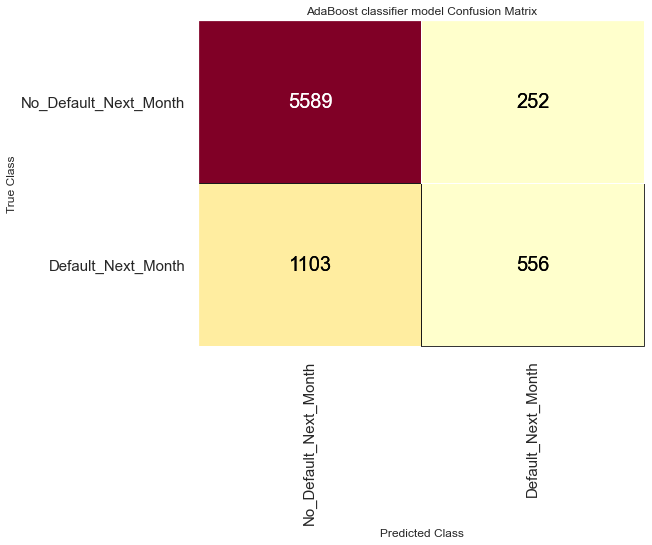

In [60]:
ada_boost_model = AdaBoostClassifier(learning_rate= 0.1,
                                     n_estimators= 500,
                                    random_state=42)
# Visualize the confusion matrix
visualize_conf_matrix(ada_boost_model, 'AdaBoost classifier model')

### We see that the accuracy over baseline improved from 78.8% to 81.93%, which is the highest accuracy so far. From the confusion matrix, we see that the AdaBoost classifier successfully predicted 556 accounts that will default next month. Next we will visualize the Precision, Recall and F-1 scores.

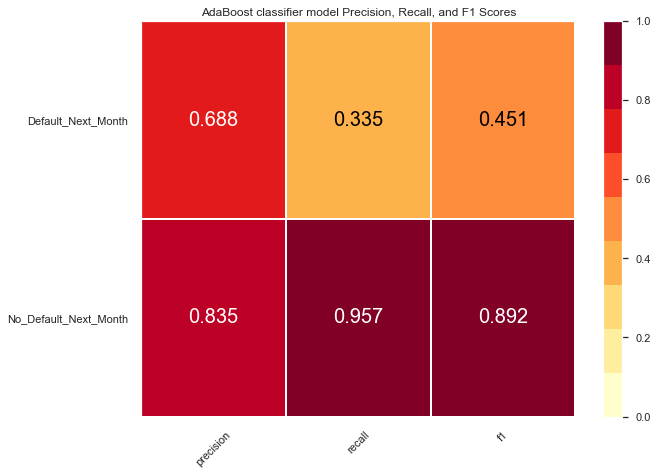

In [61]:
# Visualize the classification report
visualize_class_report(ada_boost_model, 'AdaBoost classifier model')

### The Precision score for the minority class (Default_Next_Month) is the second highest, right behind Logistic Regression. However, the Recall and F1 scores show that the AdaBoost classifier is more skilled than the tuned Logistic Regression model at predicting accounts that will default next month. Next we will look at the ROC curves. Looking at the below graph, the ROCAUC (0.76) for the AdaBoost classifier is higher than the previously highest ROCAUC (0.74) for the bagging classifier.

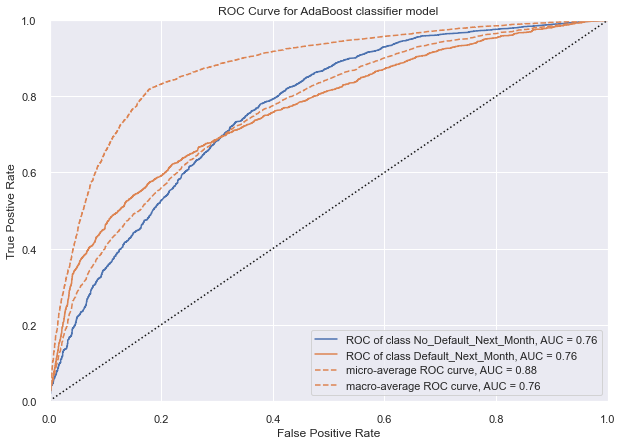

In [62]:
# Visualize the ROC Curve
roc_score = visualize_ROCAUC(ada_boost_model, 'AdaBoost classifier model')
roc_scores_list.append(roc_score)

### Next, we will tune an XGB classifier to see if we can achieve further improvements. 

In [63]:
from xgboost import XGBClassifier
model = XGBClassifier()
max_depth = range(1, 8)
n_estimators = range(2, 18, 2)
param_grid = dict(max_depth=max_depth, n_estimators=n_estimators)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(model, param_grid, scoring="accuracy", n_jobs=-1, cv=cv)
grid_result = grid_search.fit(X_train_std, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
	print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.821496 using {'max_depth': 5, 'n_estimators': 16}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 2}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 4}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 6}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 8}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 10}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 12}
0.819511 (0.007473) with: {'max_depth': 1, 'n_estimators': 14}
0.819481 (0.007427) with: {'max_depth': 1, 'n_estimators': 16}
0.820267 (0.007365) with: {'max_depth': 2, 'n_estimators': 2}
0.820370 (0.007048) with: {'max_depth': 2, 'n_estimators': 4}
0.820237 (0.007035) with: {'max_depth': 2, 'n_estimators': 6}
0.820267 (0.007092) with: {'max_depth': 2, 'n_estimators': 8}
0.820341 (0.007194) with: {'max_depth': 2, 'n_estimators': 10}
0.820533 (0.007072) with: {'max_depth': 2, 'n_estimators': 12}
0.820474 (0.006928) with: {'max_depth': 2, 'n_estimators': 14}
0.820

### Now that we have found optimal hyperparameters, we will create an XGB Classifier model using the following hyperparameters. (max_depth=5, n_estimators=16). Next, we will visualize the confusion matrix.

                        Accuracy score for the XGBoost classifier model= 81.84%



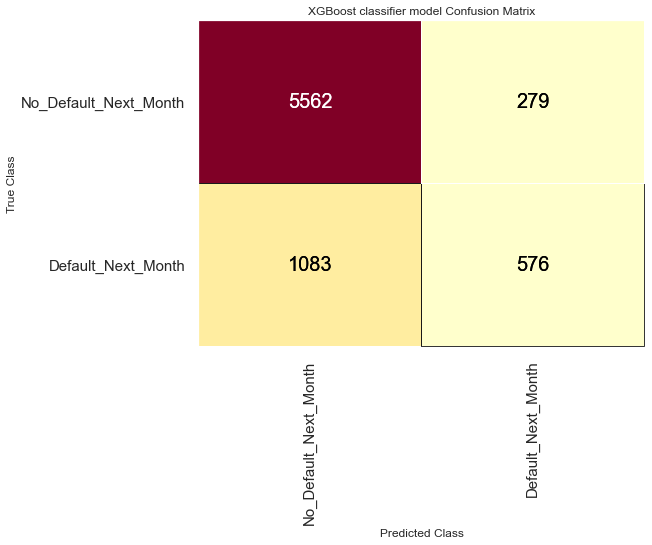

In [64]:
from xgboost import XGBClassifier
xgb_model = XGBClassifier(max_depth=5, n_estimators=16)
# Visualize the confusion matrix
visualize_conf_matrix(xgb_model, 'XGBoost classifier model')

### We see that the accuracy over baseline improved from 78.8% to 81.84%, which is slightly less than the 81.93% accuracy of the AdaBooost classifier. From the confusion matrix, we see that XGBoost classifier successfully predicted 576 accounts that will default next month. Next we will visualize the Precision, Recall and F-1 scores.

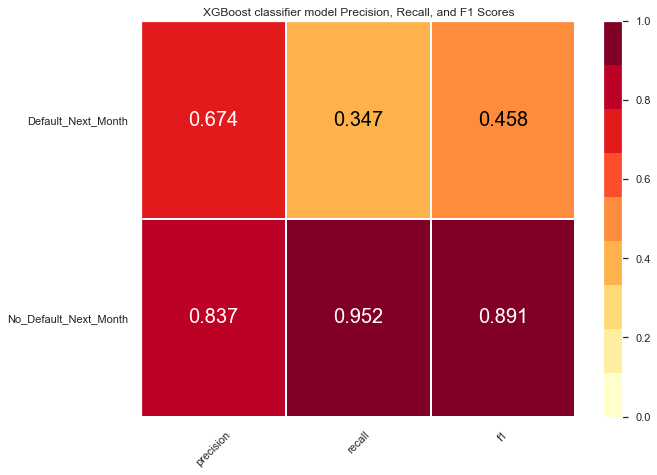

In [65]:
# Visualize the classification report
visualize_class_report(xgb_model, 'XGBoost classifier model')

### The Precision score for the minority class (Default_Next_Month) is the third highest, behind Logistic Regression and AdaBoost. However, the Recall and F1 scores show that the XGB Classifier is more skilled than both of the models at predicting accounts that will default next month. Next we will look at the ROC curves. Looking at the below graph, the ROCAUC (0.77) for the XGB Classifier is higher than the previously highest ROCAUC (0.76) for the AdaBoost classifier.

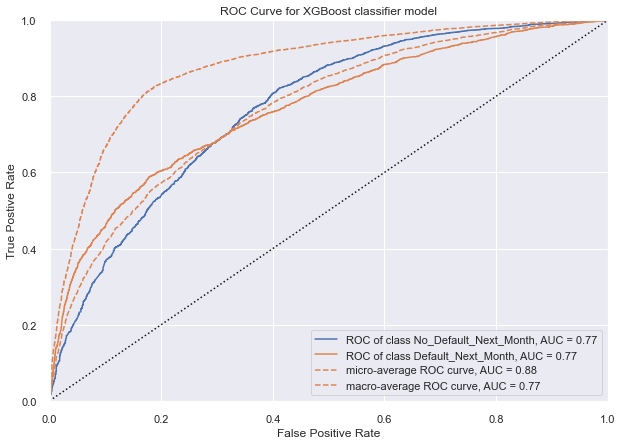

In [66]:
# Visualize the ROC Curve
roc_score = visualize_ROCAUC(xgb_model, 'XGBoost classifier model')
roc_scores_list.append(roc_score)

### Finally, we will tune a random forest classifier to see if we can make any additional improvements. 

In [67]:
# example of grid searching key hyperparameters for RandomForestClassifier
from sklearn.ensemble import RandomForestClassifier
# define models and parameters
model = RandomForestClassifier()
n_estimators = [10, 50, 100, 200]
max_features = ['sqrt', 'log2']
max_depth = [3, 6, 9, 12]

# define grid search
grid = dict(n_estimators=n_estimators,max_features=max_features, max_depth=max_depth)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',refit=True)
grid_result = grid_search.fit(X_train_std, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.822252 using {'max_depth': 12, 'max_features': 'sqrt', 'n_estimators': 200}
0.811170 (0.010159) with: {'max_depth': 3, 'max_features': 'sqrt', 'n_estimators': 10}
0.811052 (0.008844) with: {'max_depth': 3, 'max_features': 'sqrt', 'n_estimators': 50}
0.812281 (0.008151) with: {'max_depth': 3, 'max_features': 'sqrt', 'n_estimators': 100}
0.816222 (0.007269) with: {'max_depth': 3, 'max_features': 'sqrt', 'n_estimators': 200}
0.806474 (0.012177) with: {'max_depth': 3, 'max_features': 'log2', 'n_estimators': 10}
0.812919 (0.010994) with: {'max_depth': 3, 'max_features': 'log2', 'n_estimators': 50}
0.814237 (0.008741) with: {'max_depth': 3, 'max_features': 'log2', 'n_estimators': 100}
0.813941 (0.007532) with: {'max_depth': 3, 'max_features': 'log2', 'n_estimators': 200}
0.818800 (0.006905) with: {'max_depth': 6, 'max_features': 'sqrt', 'n_estimators': 10}
0.820119 (0.007230) with: {'max_depth': 6, 'max_features': 'sqrt', 'n_estimators': 50}
0.820089 (0.007174) with: {'max_depth': 6,

### Now that we have found optimal hyperparameters, we will create a Random Forest model using the following hyperparameters. (max_depth=12, max_features='sqrt',n_estimators=200). Next, we will visualize the confusion matrix.

                        Accuracy score for the Random Forest classifier model= 81.96%



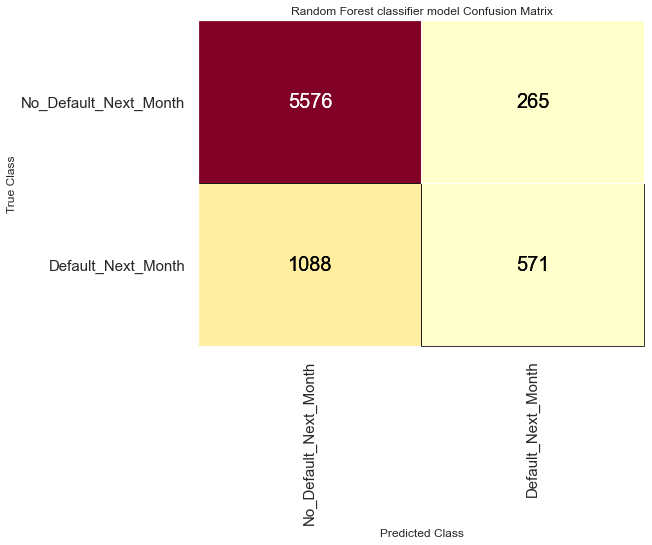

In [68]:
# Instantiate a random forest model with the optimized hyperparameters
rf_model = RandomForestClassifier(max_depth=12,
                                  max_features='sqrt',
                                  n_estimators=200,
                                 random_state=42)

# Visualize the confusion matrix
visualize_conf_matrix(rf_model, 'Random Forest classifier model')

### We see that the accuracy over baseline improved from 78.8% to 81.96%, which is the highest overall. Next we will look at the Precision, Recall and F1 scores.

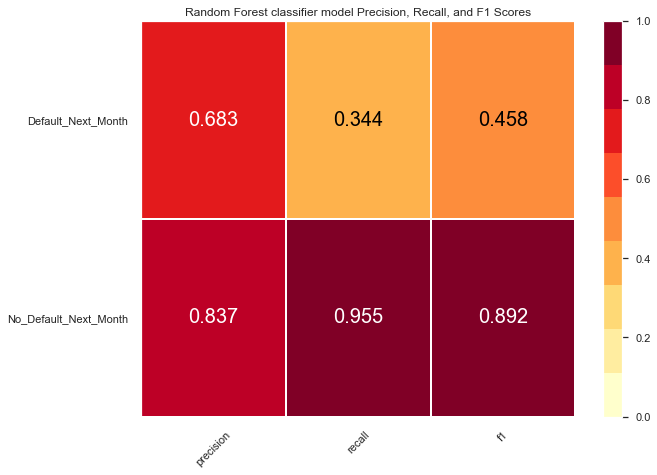

In [69]:
# Visualize the classification report
visualize_class_report(rf_model, 'Random Forest classifier model')

### The Recall and F1 scores show that the random forest is almost as skilled as the XGB classifier at predicting accounts that will default next month. Next we will visualize the ROC curves.

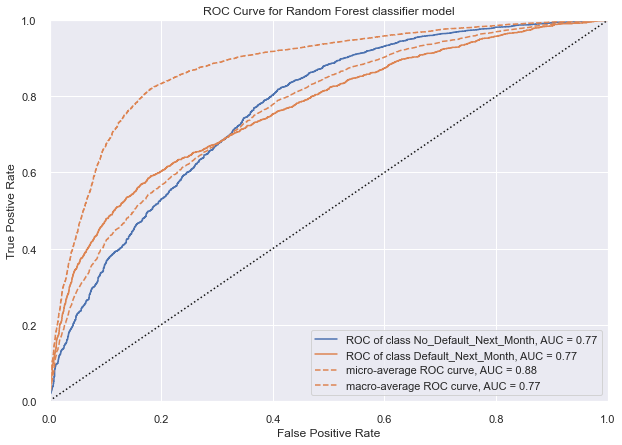

In [70]:
# Visualize the ROC Curve
roc_score = visualize_ROCAUC(rf_model, 'Random Forest classifier model')
roc_scores_list.append(roc_score)

### Looking at the above graph the ROC score (0.77) for the random forest classifier, which is tied with the XGB classifier for highest score. 

### Before we make our conclusions, let's take a look at all six of the models evaluated side by side for each metric. We can do this by creating a list of the six models and a list of the six model descriptions. We zip the two lists together, and for each model and description in the zipped list we:  
#### First visualize each confusion matrix in turn.
#### Then visualize each classification report in turn.    
#### Then visualize each ROC curve in turn.
#### Finally, we will use a bar graph to compare ROC AUC scores for all models.

                        Accuracy score for the Tuned Logistic Regression model= 81.35%



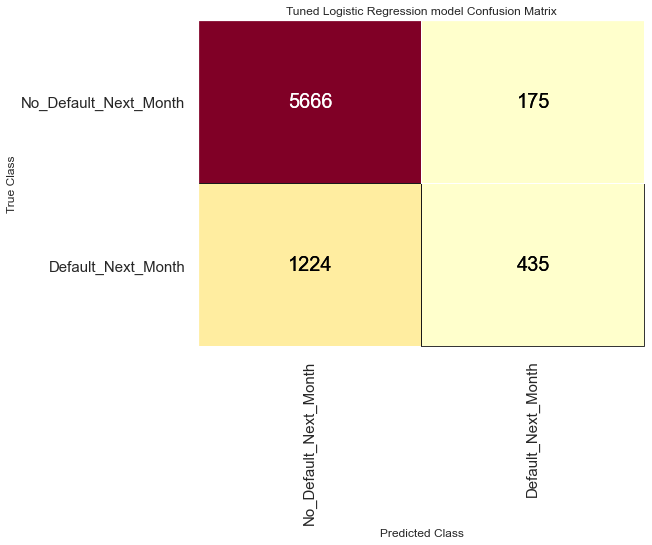


                        Accuracy score for the KNN classifier model= 81.04%



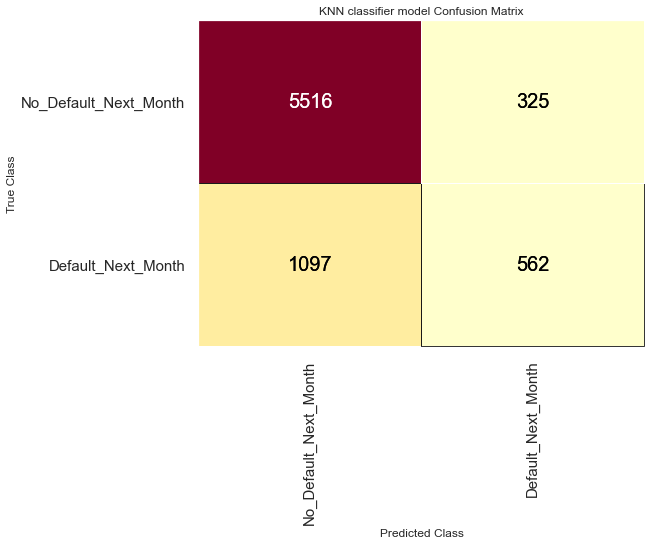


                        Accuracy score for the Bagging Classifier model= 81.07%



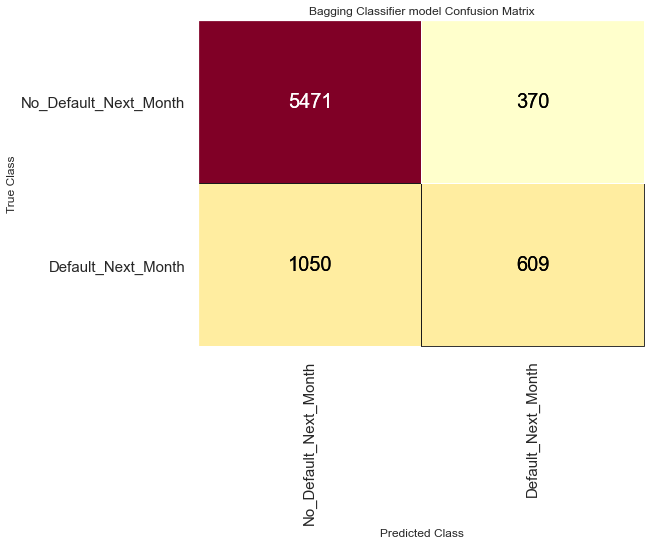


                        Accuracy score for the AdaBoost classifier model= 81.93%



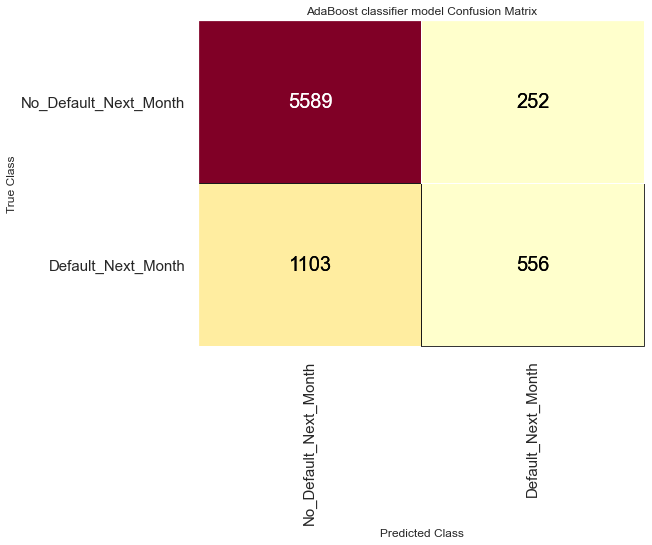


                        Accuracy score for the XGBoost classifier model= 81.84%



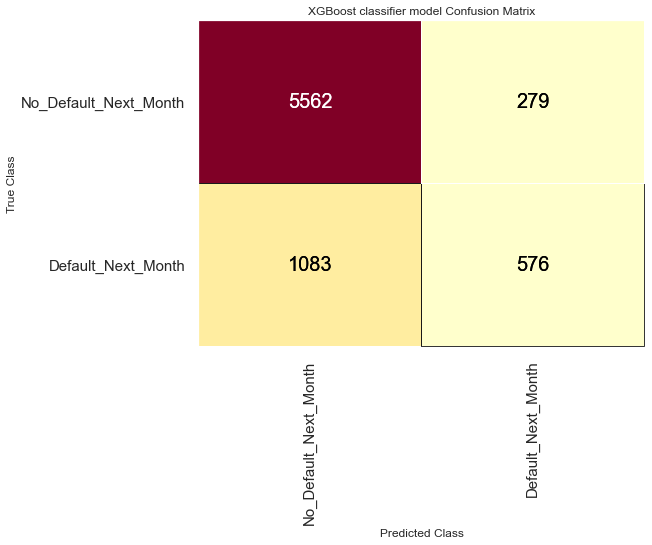


                        Accuracy score for the Random Forest classifier model= 81.96%



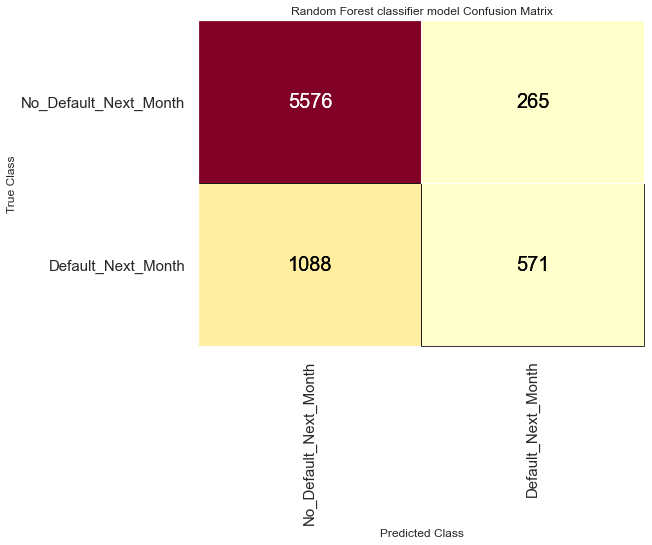

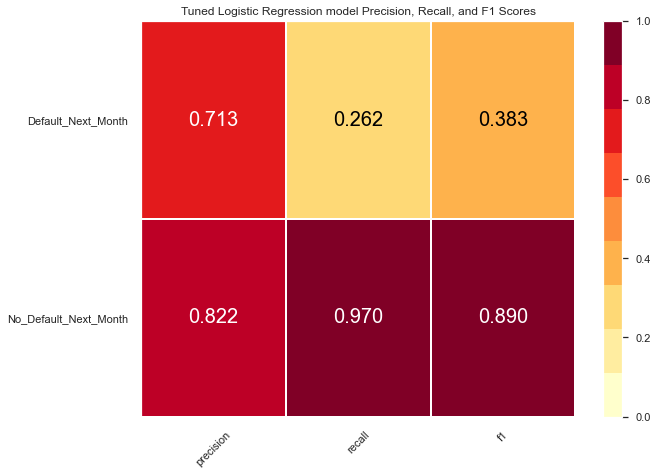

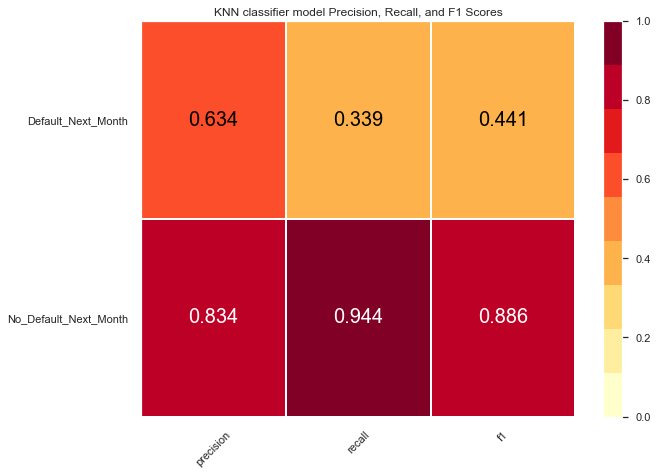

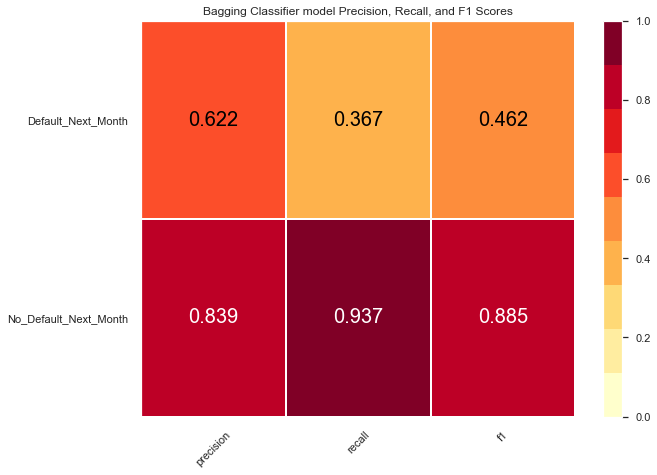

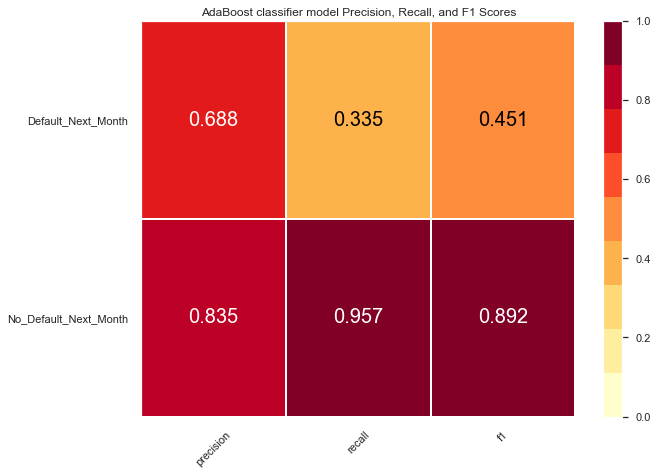

...

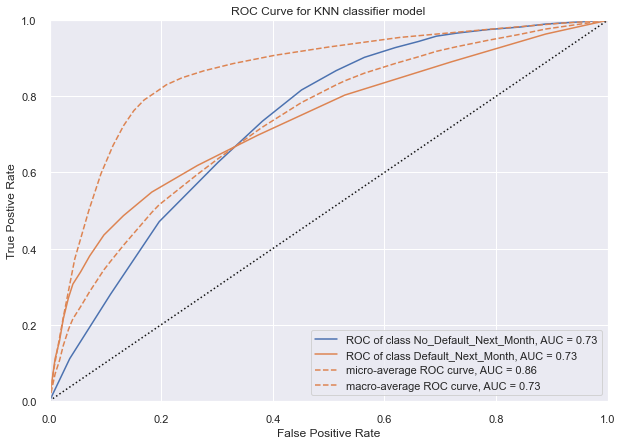

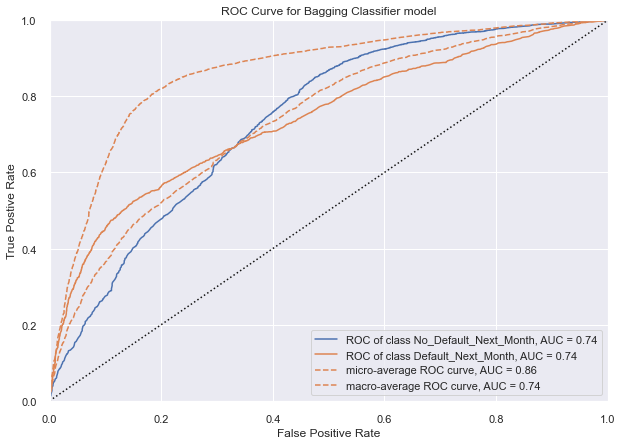

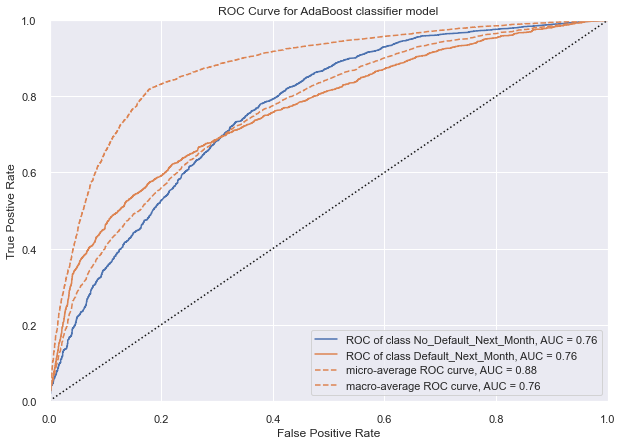

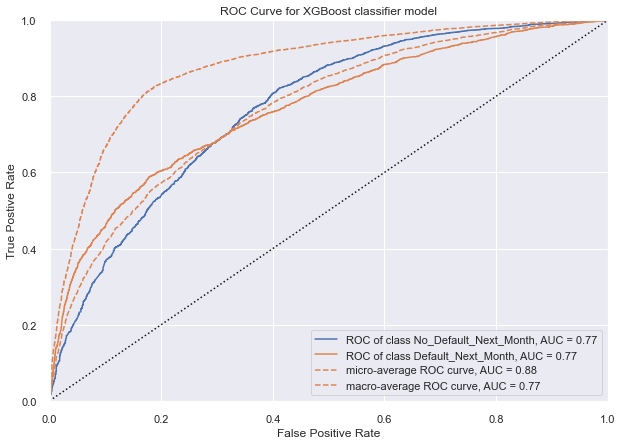

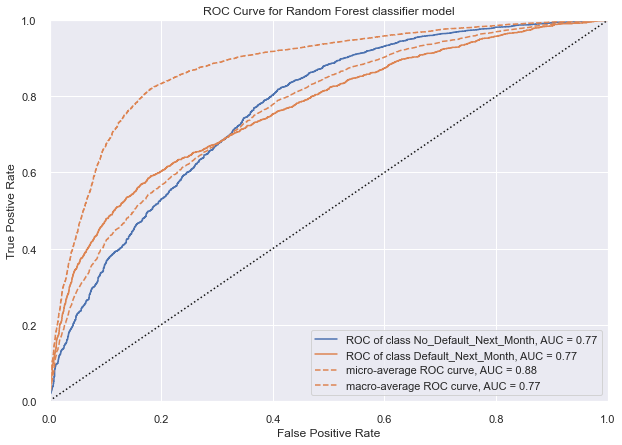

In [71]:
# Make a list of all the models tested
models_list=[tuned_log_model,knn_model,
             bagging_model,ada_boost_model,
             xgb_model,rf_model]

# Make a list of all the model descriptions
models_description=['Tuned Logistic Regression model',
                   'KNN classifier model',
                   'Bagging Classifier model',
                   'AdaBoost classifier model',
                   'XGBoost classifier model',
                   'Random Forest classifier model']

# Visualize all the confusion matrices side by side
for model, description in zip(models_list, models_description):
    visualize_conf_matrix(model, description)
    print('')
    
# Visualize all the classification reports side by side   
for model, description in zip(models_list, models_description):
    visualize_class_report(model, description)
    print('')
    
# Visualize all the ROC curves side by side  
for model, description in zip(models_list, models_description):
    visualize_ROCAUC(model, description)
    print('')

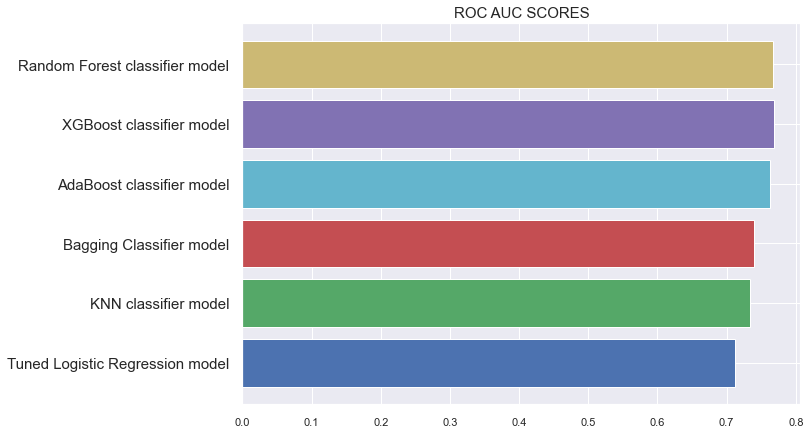

In [72]:
# Plot a bar graph of the ROC AUC scores
plt.yticks(range(len(roc_scores_list)), models_description,fontsize=15)
plt.title('ROC AUC SCORES',fontsize=15)
plt.barh(range(len(roc_scores_list)), roc_scores_list, color='bgrcmy') 
plt.show()

## Conclusions.  
The logistic regression model accurately predicted the majority class better than the other models but had the lowest recall and F1 scores for the minority class. The minority class is what we are trying to predict, which is if a customer account will default in the next month. For this reason, the Logistic Regression model is the least useful model. The Bagging classifier had the highest F1 score (was most skillful) for predicting the minority class but had the lowest F1 score (was least skillful) for predicting the majority class.  

The ROC Curves show that the random forest ensemble model had the highest ROC score at 0.77 and the steepest ROC curve.  The steepness of the random forest ROC curve indicates that it is the best at maximizing the true positive rate while minimizing the false positive rate. Additionally, the random forest model had the second highest F1 score for predicting the minority class and the highest F1 score for predicting the majority class. Random forest also had the highest accuracy. For these reasons, random forest appears to be the winner, with XGBoost coming in at a very close second place. 